In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
 %pip install segment-geospatial groundingdino-py leafmap localtileserver

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.3/82.3 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 4.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.8/152.8 kB 8.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.8/87.8 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 567.9/567.9 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 109.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 104.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.7/220.7 kB 21.2 M

In [ ]:
import leafmap
from samgeo.text_sam import LangSAM

 LangSAM is available!

MEDICAL TEXT PROMPT SEGMENTATION + NMS
Text Prompts: 4 prompts
   1. 'highlight the raised circular lesion (polyp) inside the colon'
   2. 'small red bump inside the colon'
   3. 'soft tissue protrusion on colon lining'
   4. 'irregular lump in colon view'
Technology: LangSAM (GroundingDINO + SAM) + Non-Max Suppression
 NMS IoU Threshold: 0.4

🤖Initializing LangSAM (this may take a few minutes)...


GroundingDINO_SwinB.cfg.py:   0%|          | 0.00/1.01k [00:00<?, ?B/s]

final text_encoder_type: bert-base-uncased


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

groundingdino_swinb_cogcoor.pth:   0%|          | 0.00/938M [00:00<?, ?B/s]

Downloading: "https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth" to /root/.cache/torch/hub/checkpoints/sam_vit_b_01ec64.pth
100%|██████████| 358M/358M [01:40<00:00, 3.74MB/s]


LangSAM initialized successfully with vit_b model!
 Found 200 total JPG files
 Limited to first 20 files

 Processing 20 images with 4 text prompts each + NMS

📷Processing 1/20: cjyzu3reghjya0794w7pwoi50.jpg

Processing: cjyzu3reghjya0794w7pwoi50.jpg
Testing 4 text prompts...

 Image Information:
Dimensions: 720x576 pixels
Total area: 414720 pixels
  Prompt 1/4: 'highlight the raised circular lesion (polyp) insid...'
Removed largest box (area: 338746.7) — 13 boxes remaining
Removed largest box (area: 221579.0) — 10 boxes remaining
      🔍 NMS: 13 → 2 boxes (removed 8 overlapping)
     Found 2 detection(s) after NMS
  Prompt 2/4: 'small red bump inside the colon'
Removed largest box (area: 336209.2) — 12 boxes remaining
Removed largest box (area: 216464.3) — 11 boxes remaining
      🔍 NMS: 12 → 5 boxes (removed 6 overlapping)
     Found 5 detection(s) after NMS
  Prompt 3/4: 'soft tissue protrusion on colon lining'
Removed largest box (area: 338674.8) — 6 boxes remaining
Removed largest

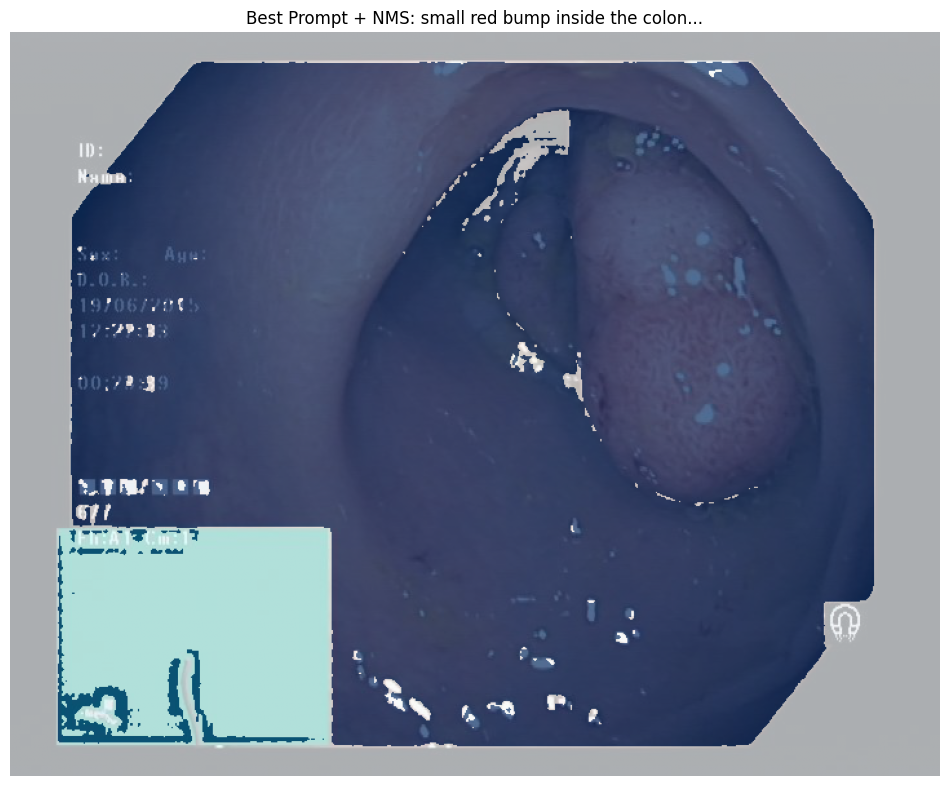

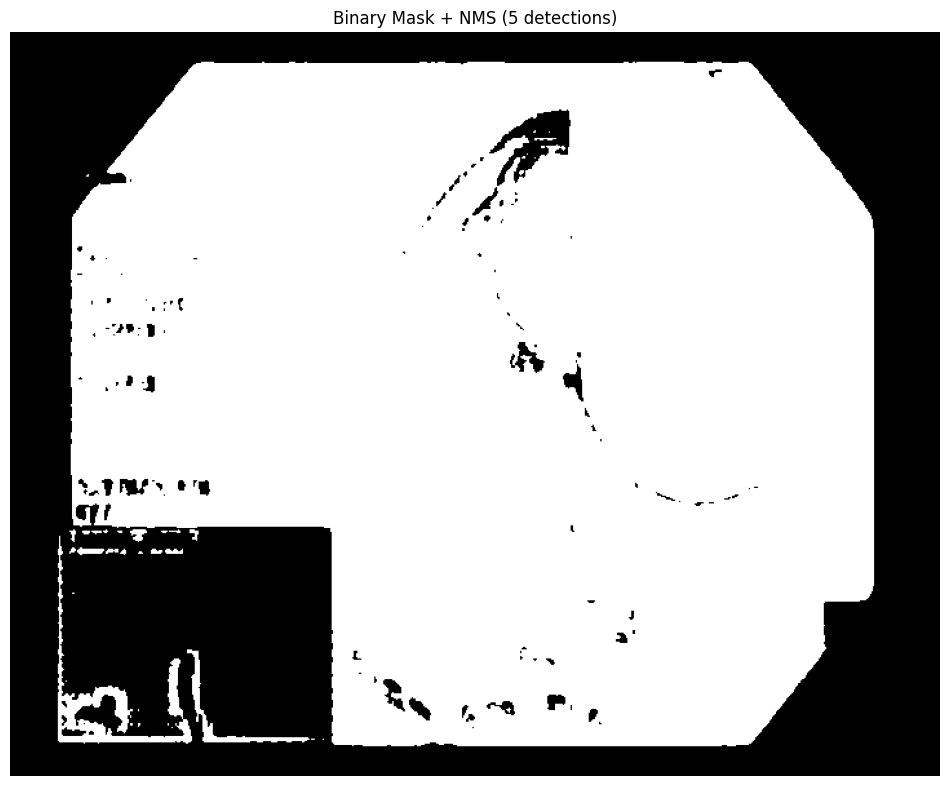

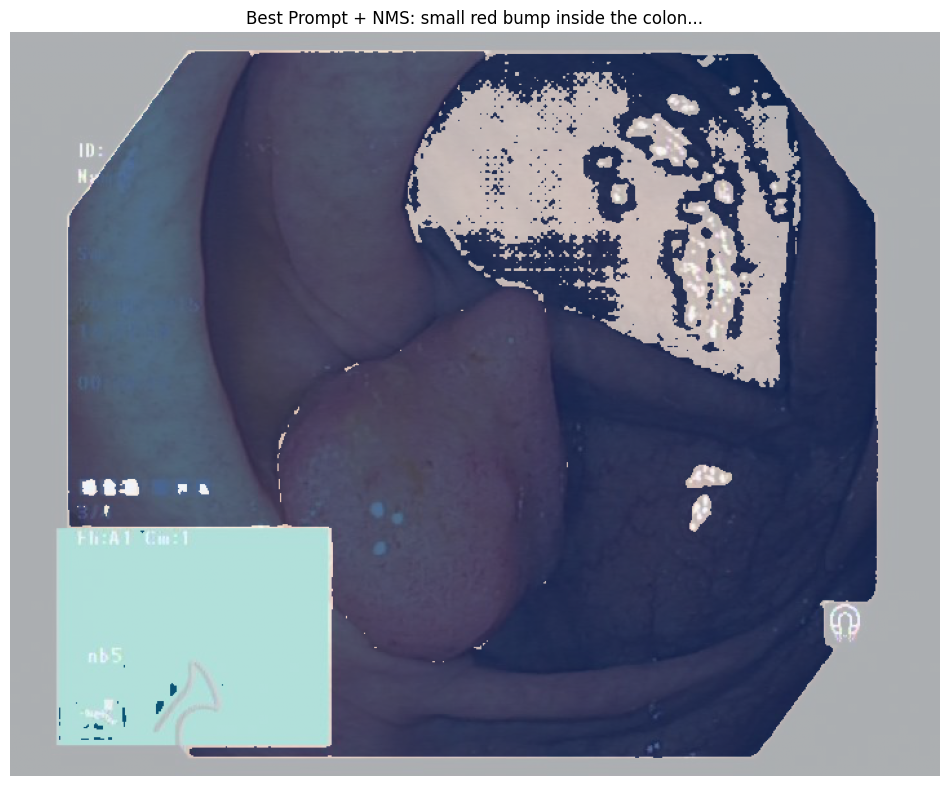

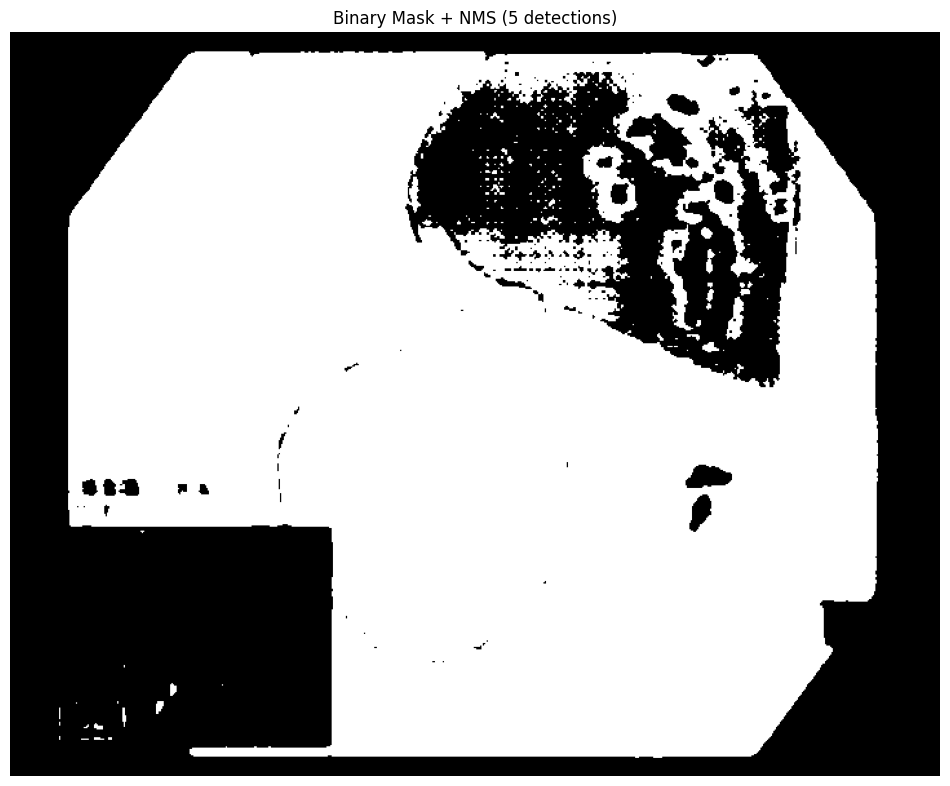

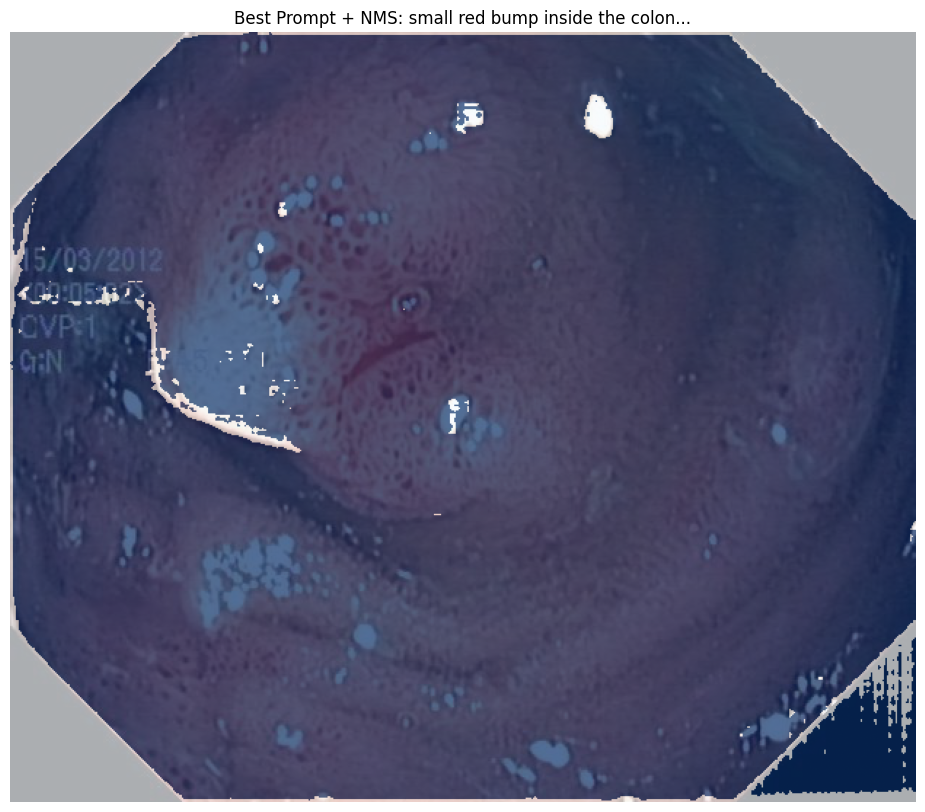

...

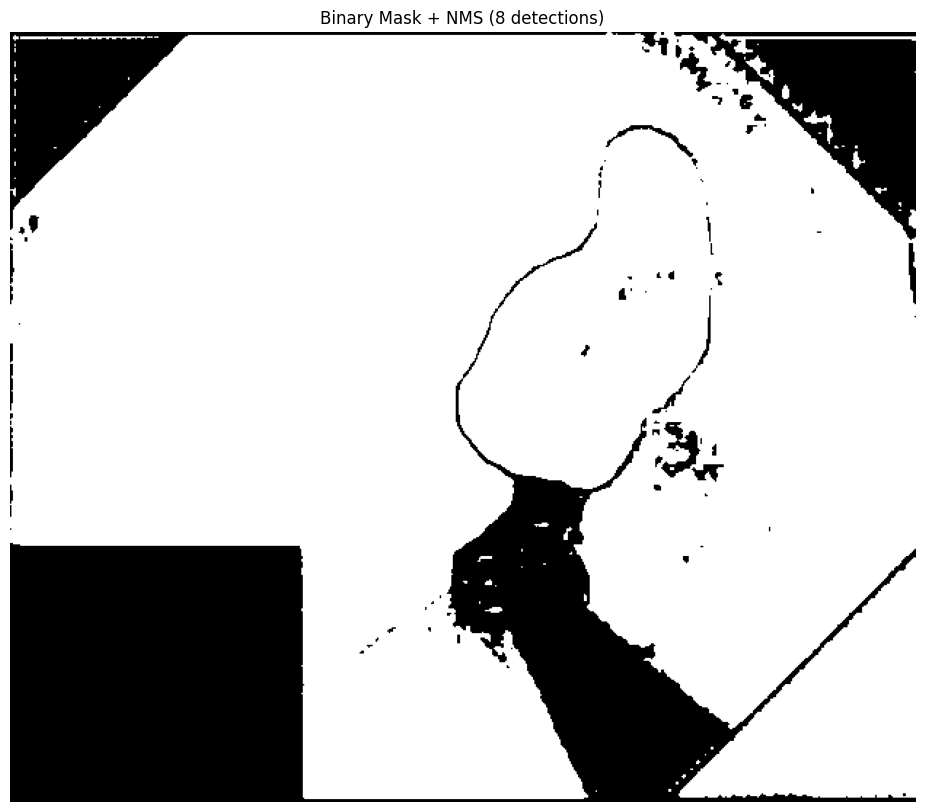

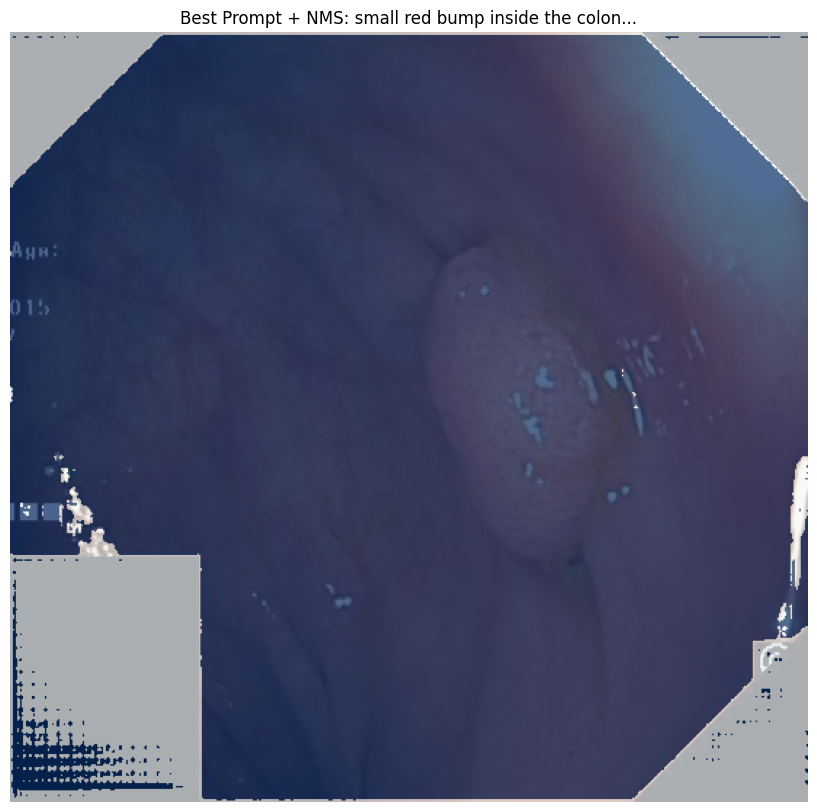

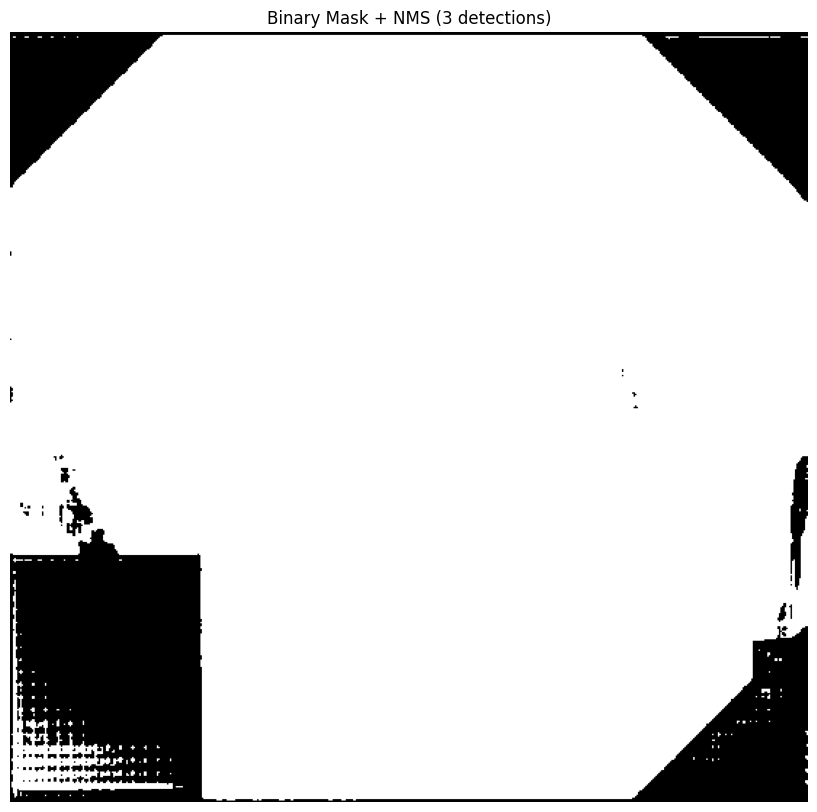

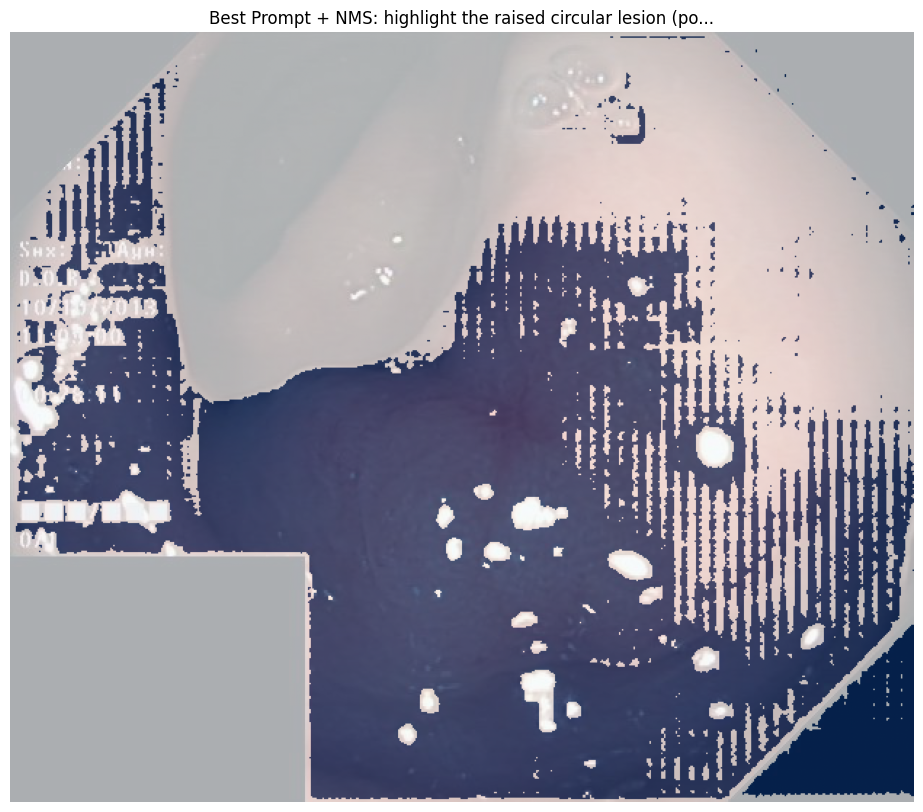

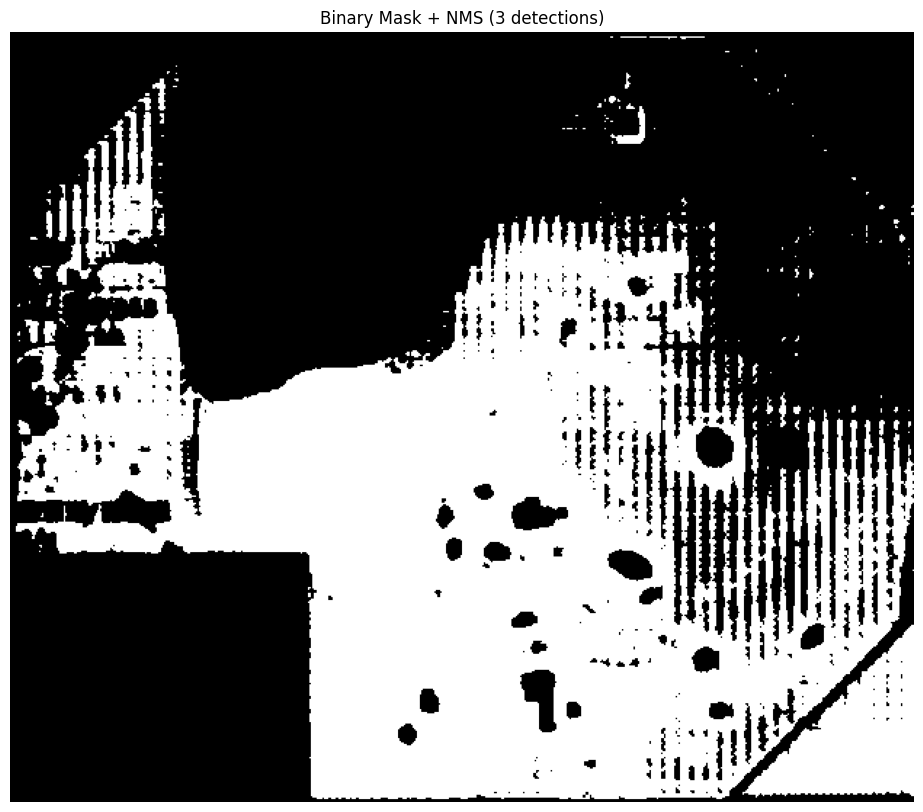

In [ ]:
#!/usr/bin/env python3
"""jun12 11:15
"""

import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import cv2
from PIL import Image as PILImage
import torch
from torchvision.ops import nms
import warnings
warnings.filterwarnings('ignore')


MAX_BOX_AREA = 0.5 * 1920 * 1080  # Maximum box area threshold

#Text prompts optimized for polyp detection
TEXT_PROMPTS = [
    "highlight the raised circular lesion (polyp) inside the colon",
    "small red bump inside the colon",
    "soft tissue protrusion on colon lining",
    "irregular lump in colon view"
]

# Input/Output configuration
IMAGES_DIR = "/content/drive/MyDrive/val_images"
OUTPUT_DIR = "/content/drive/MyDrive/langsam_results_no_outerbox12_1100"
MAX_FILES = 20  # Process first 20 images for testing

# Detection thresholds
BOX_THRESHOLD = 0.15    # Object detection confidence
TEXT_THRESHOLD = 0.15   # Text-object association confidence
NMS_IOU_THRESHOLD = 0.4 # Non-Max Suppression IoU threshold

# Try to import LangSAM
try:
    from samgeo.text_sam import LangSAM
    LANGSAM_AVAILABLE = True
    print(" LangSAM is available!")
except ImportError:
    LANGSAM_AVAILABLE = False
    print("  LangSAM not available!")
    print(" Install with: pip install segment-geospatial groundingdino-py")
def remove_largest_box(boxes, scores=None, phrases=None):
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Compute area for each box
    areas = [(x2 - x1) * (y2 - y1) for (x1, y1, x2, y2) in boxes]
    largest_idx = np.argmax(areas)

    print(f"Removed largest box (area: {areas[largest_idx]:.1f}) — {len(boxes)-1} boxes remaining")

    # Remove the largest box
    boxes = np.delete(boxes, largest_idx, axis=0)
    if scores is not None:
        scores = np.delete(scores, largest_idx, axis=0)
    if phrases is not None:
        phrases = [phrases[i] for i in range(len(phrases)) if i != largest_idx]

    return boxes, scores, phrases

def is_outer_box(box, image_size, threshold=0.7, pixel_margin=10):
    h, w = image_size
    x1, y1, x2, y2 = box

    box_width = x2 - x1
    box_height = y2 - y1
    box_area = box_width * box_height
    image_area = h * w

    # Ratios
    width_ratio = box_width / w
    height_ratio = box_height / h

    # Pixel margin check
    near_left = x1 <= pixel_margin
    near_right = x2 >= (w - pixel_margin)
    near_top = y1 <= pixel_margin
    near_bottom = y2 >= (h - pixel_margin)
    near_all_edges = near_left and near_right and near_top and near_bottom

    # Area ratio
    area_ratio = box_area / image_area

    # Outer if: very large, or covers almost all the image, or touches all borders
    is_outer = (
        width_ratio > 0.90 and height_ratio > 0.90 or
        area_ratio > 0.90 or
        near_all_edges
    )

    # Debug print
    print(f"\nAnalyzing box:")
    print(f"  Size: {box_width:.1f}x{box_height:.1f} (Area: {box_area:.1f} pixels)")
    print(f"  Image size: {w}x{h}")
    print(f"  Width ratio: {width_ratio:.3f}")
    print(f"  Height ratio: {height_ratio:.3f}")
    print(f"  Area ratio: {area_ratio:.3f}")
    print(f"  Edges: left={near_left}, right={near_right}, top={near_top}, bottom={near_bottom}")
    print(f"  Final decision: {'Outer box' if is_outer else 'Inner box'}")

    return is_outer

def remove_outer_boxes(boxes, scores=None, phrases=None, image_size=None):
    """
    Remove boxes that are likely outer box rectangles.

    Args:
        boxes: List of [x1, y1, x2, y2] coordinates
        scores: Optional list of confidence scores
        phrases: Optional list of text phrases
        image_size: (height, width) of the image

    Returns:
        Filtered boxes, scores, and phrases
    """
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Convert to numpy arrays if needed
    boxes = np.array(boxes)
    if scores is not None:
        scores = np.array(scores)

    # Print debug information about all boxes
    print("\n Box Size Analysis:")
    print("="*50)
    h, w = image_size
    image_area = h * w
    print(f"Image dimensions: {w}x{h} (Area: {image_area} pixels)")
    print("\nAll detected boxes:")
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        area = width * height
        area_ratio = area / image_area
        print(f"Box {i+1}:")
        print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
        print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
        print(f"  Area ratio: {area_ratio:.3f}")
        if scores is not None:
            print(f"  Score: {scores[i]:.3f}")

    # Keep track of boxes to remove
    keep_indices = []

    print("\nAnalyzing outer boxes:")
    for i, box in enumerate(boxes):
        if not is_outer_box(box, image_size):
            keep_indices.append(i)
        else:
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1} identified as outer box:")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")

    # Filter results
    filtered_boxes = boxes[keep_indices]
    filtered_scores = scores[keep_indices] if scores is not None else None
    filtered_phrases = [phrases[i] for i in keep_indices] if phrases is not None else None

    removed_count = len(boxes) - len(filtered_boxes)
    if removed_count > 0:
        print(f"\n🧹 Removed {removed_count} outer box(es) — {len(filtered_boxes)} boxes remaining")

        # Print information about remaining boxes
        print("\nRemaining boxes:")
        for i, box in enumerate(filtered_boxes):
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1}:")
            print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")
            if filtered_scores is not None:
                print(f"  Score: {filtered_scores[i]:.3f}")

    return filtered_boxes, filtered_scores, filtered_phrases

def apply_nms_to_detections(boxes, scores=None, iou_threshold=0.4):
    """Apply Non-Max Suppression to filter overlapping detections."""
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, 0

    try:
        # Convert to torch tensors if not already
        if not isinstance(boxes, torch.Tensor):
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
        else:
            boxes_tensor = boxes.clone()

        # Handle scores
        if scores is not None:
            if not isinstance(scores, torch.Tensor):
                scores_tensor = torch.tensor(scores, dtype=torch.float32)
            else:
                scores_tensor = scores.clone()
        else:
            scores_tensor = torch.ones(len(boxes_tensor), dtype=torch.float32)

        # Apply NMS
        keep_indices = nms(boxes_tensor, scores_tensor, iou_threshold=iou_threshold)

        # Filter results
        filtered_boxes = boxes_tensor[keep_indices].numpy()
        filtered_scores = scores_tensor[keep_indices].numpy() if scores is not None else None

        return filtered_boxes, filtered_scores, len(boxes) - len(filtered_boxes)

    except Exception as e:
        print(f" NMS failed: {e}, using original detections")
        return boxes, scores, 0

def process_single_image_multi_prompts(image_path, text_prompts, sam_model):
    """Process a single image with multiple text prompts and combine results."""
    filename = Path(image_path).stem
    print(f"\nProcessing: {Path(image_path).name}")
    print(f"Testing {len(text_prompts)} text prompts...")

    try:
        # Load and prepare image
        image = PILImage.open(image_path).convert('RGB')
        image_size = image.size[::-1]  # (height, width)

        # Print image information
        print(f"\n Image Information:")
        print(f"Dimensions: {image_size[1]}x{image_size[0]} pixels")
        print(f"Total area: {image_size[0] * image_size[1]} pixels")

        # Save temporary image for LangSAM
        output_dir = Path(OUTPUT_DIR)
        output_dir.mkdir(exist_ok=True)
        temp_image_path = output_dir / f"{filename}_temp.jpg"
        image.save(temp_image_path)

        # Store all results from different prompts
        all_results = []
        successful_prompts = []
        total_boxes_before_nms = 0
        total_boxes_after_nms = 0

        # Run text-prompted segmentation for each prompt
        for i, text_prompt in enumerate(text_prompts, 1):
            try:
                print(f"  Prompt {i}/{len(text_prompts)}: '{text_prompt[:50]}{'...' if len(text_prompt) > 50 else ''}'")
                sam_model.predict(
                    str(temp_image_path),
                    text_prompt,
                    box_threshold=BOX_THRESHOLD,
                    text_threshold=TEXT_THRESHOLD
                )
                # Remove the largest box AFTER final prediction
                if hasattr(sam_model, 'boxes') and sam_model.boxes is not None and len(sam_model.boxes) > 1:
                  sam_model.boxes, sam_model.scores, _ = remove_largest_box(
                  sam_model.boxes,
                  sam_model.scores if hasattr(sam_model, 'scores') else None,
                  sam_model.phrases if hasattr(sam_model, 'phrases') else None
              )


                # Check if any detections were found
                if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
                    original_boxes = sam_model.boxes
                    original_scores = sam_model.scores if hasattr(sam_model, 'scores') else None

                    # Get image dimensions
                    img_width, img_height = image.size
                    img_area = img_width * img_height
                    AREA_THRESHOLD = 0.8 * img_area

                    # Filter out large boxes (> 80% of image area)
                    filtered_box_list = []
                    filtered_score_list = []

                    for idx, box in enumerate(original_boxes):
                        x1, y1, x2, y2 = box
                        box_area = (x2 - x1) * (y2 - y1)
                        if box_area <= AREA_THRESHOLD:
                            filtered_box_list.append(box)
                            if original_scores is not None:
                                filtered_score_list.append(original_scores[idx])

                    # If nothing remains, skip this prompt
                    if len(filtered_box_list) == 0:
                        print(f"      All boxes removed by area filter (>80% of image area)")
                        continue

                    # Convert to NumPy
                    filtered_boxes_np = np.array(filtered_box_list)
                    filtered_scores_np = np.array(filtered_score_list) if original_scores is not None else None
                    # ✅ Remove largest box if more than one remains
                    if len(filtered_box_list) > 1:
                        filtered_boxes_np, filtered_scores_np, _ = remove_largest_box(
                            filtered_boxes_np,
                            filtered_scores_np,
                            sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        )
                    # Apply NMS
                    filtered_boxes, filtered_scores, removed_count = apply_nms_to_detections(
                        filtered_boxes_np,
                        filtered_scores_np,
                        NMS_IOU_THRESHOLD
                    )

                    if len(filtered_boxes) > 0:
                        print(f"      🔍 NMS: {len(original_boxes)} → {len(filtered_boxes)} boxes (removed {removed_count} overlapping)")
                        # Update the model's attributes with filtered results
                        sam_model.boxes = filtered_boxes
                        if hasattr(sam_model, 'scores') and filtered_scores is not None:
                            sam_model.scores = filtered_scores

                        all_results.append({
                            'prompt': text_prompt,
                            'boxes': filtered_boxes,
                            'original_boxes': original_boxes,
                            'boxes_removed': removed_count,
                            'masks': sam_model.masks if hasattr(sam_model, 'masks') else None,
                            'phrases': sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        })
                        successful_prompts.append(text_prompt)
                        total_boxes_before_nms += len(original_boxes)
                        total_boxes_after_nms += len(filtered_boxes)
                        print(f"     Found {len(filtered_boxes)} detection(s) after NMS")
                    else:
                        print(f"     All boxes removed by NMS")
                else:
                    print(f"        No detections found")
            except Exception as e:
                print(f"        Error with prompt: {e}")
                continue

        if not all_results:
            print(f"  No polyps detected with any prompt for {Path(image_path).name}")
            return False

        print(f"Successfully detected polyps with {len(successful_prompts)}/{len(text_prompts)} prompts")
        print(f"NMS Summary: {total_boxes_before_nms} → {total_boxes_after_nms} total boxes (removed {total_boxes_before_nms - total_boxes_after_nms} overlapping)")

               # Use the best result (most detections) for final output
        best_result = max(all_results, key=lambda x: len(x['boxes']) if x['boxes'] is not None else 0)
        print(f"Final selected prompt has {len(best_result['boxes'])} boxes")
        # Save visualization of all filtered boxes
        try:
            all_boxes_output = output_dir / f"{filename}_all_boxes.png"
            all_box_image = np.array(image.copy())

            for i, box in enumerate(best_result['boxes']):
                x1, y1, x2, y2 = [int(coord) for coord in box]
                cv2.rectangle(all_box_image, (x1, y1), (x2, y2), (0, 255, 0), 2)
                cv2.putText(all_box_image, f"Box {i+1}", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

            plt.figure(figsize=(10, 8))
            plt.imshow(all_box_image)
            plt.title(f"All Boxes ({len(best_result['boxes'])}) — Best Prompt")
            plt.axis('off')
            plt.tight_layout()
            plt.savefig(all_boxes_output, dpi=150, bbox_inches='tight')
            plt.close()
            print(f"Saved all-boxes image: {all_boxes_output}")
        except Exception as e:
            print(f"Could not save all-boxes image: {e}")

                # Save combined binary mask of all masks
        try:
            combined_mask_output = output_dir / f"{filename}_combined_mask.png"
            combined_mask = np.zeros((image.height, image.width), dtype=np.uint8)

            for mask in best_result['masks']:
                if isinstance(mask, torch.Tensor):
                    mask = mask.cpu().numpy()
                combined_mask = np.logical_or(combined_mask, mask.astype(np.uint8))

            plt.figure(figsize=(10, 8))
            plt.imshow(combined_mask * 255, cmap='gray')
            plt.title(f"Combined Binary Mask ({len(best_result['boxes'])} detections)")
            plt.axis('off')
            plt.tight_layout()
            plt.savefig(combined_mask_output, dpi=150, bbox_inches='tight')
            plt.close()
            print(f"Saved combined mask: {combined_mask_output}")
        except Exception as e:
            print(f"Could not save combined binary mask: {e}")


        best_prompt = best_result['prompt']

        print(f"Best result from: '{best_prompt[:50]}{'...' if len(best_prompt) > 50 else ''}' ({len(best_result['boxes'])} detections)")

        # Reuse best_result instead of rerunning predict()
        sam_model.boxes = best_result['boxes']
        sam_model.scores = best_result['scores'] if 'scores' in best_result else None
        sam_model.masks = best_result['masks'] if 'masks' in best_result else None

        sam_model.phrases = best_result['phrases']

        # Apply NMS to final result
        if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
            filtered_boxes, filtered_scores, _ = apply_nms_to_detections(
                sam_model.boxes,
                sam_model.scores if hasattr(sam_model, 'scores') else None,
                NMS_IOU_THRESHOLD
            )
            sam_model.boxes = filtered_boxes
            if hasattr(sam_model, 'scores') and filtered_scores is not None:
                sam_model.scores = filtered_scores

        # Save results
        try:
            # Create visualization with bounding boxes
            bbox_output = output_dir / f"{filename}_with_boxes.png"

            # Load original image
            img_with_boxes = cv2.imread(str(image_path))
            if img_with_boxes is None:
                img_with_boxes = np.array(image)
            else:
                img_with_boxes = cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB)

            # Draw bounding boxes and save masks
            for i, box in enumerate(best_result['boxes']):
                x1, y1, x2, y2 = [int(coord) for coord in box]
                annotated_img = img_with_boxes.copy()

                # Draw rectangle
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (255, 0, 0), 3)

                # Draw score (optional)
                score = sam_model.scores[i] if sam_model.scores is not None else None
                if score is not None:
                    cv2.putText(annotated_img, f'{score:.2f}', (x1, y1 - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

                # Save image with box
                per_box_output = output_dir / f"{filename}_box{i+1}.png"
                plt.figure(figsize=(10, 7))
                plt.imshow(annotated_img)
                plt.title(f"Box {i+1} (Score: {score:.2f}) — Prompt: {best_prompt[:40]}..." if score else f"Box {i+1}")
                plt.axis('off')
                plt.tight_layout()
                plt.savefig(per_box_output, dpi=150, bbox_inches='tight')
                plt.close()
                print(f"Saved: {per_box_output}")

                # Save binary mask
                if best_result['masks'] is not None and i < len(best_result['masks']):

                    mask = best_result['masks'][i]
                    if isinstance(mask, torch.Tensor):
                        mask = mask.cpu().numpy()  # Convert to NumPy
                    mask_output = output_dir / f"{filename}_mask{i+1}.png"
                    plt.imsave(mask_output, mask.astype(np.uint8) * 255, cmap='gray')

                    print(f"Saved mask: {mask_output}")
                else:
                    print(f"No mask found for box {i+1}")




            # Save mask visualization
            try:
                mask_output = output_dir / f"{filename}_mask_only.png"
                sam_model.show_anns(
                    cmap="Blues",
                    add_boxes=False,
                    alpha=0.7,
                    title=f"Best Prompt + NMS: {best_prompt[:40]}...",
                    output=str(mask_output)
                )
                print(f"  Saved: {mask_output}")
            except Exception as e:
                print(f"   Warning: Could not save mask image ({e})")
                mask_output = None

            # Save binary mask
            try:
                binary_output = output_dir / f"{filename}_binary.png"

                # Try to create binary mask manually if show_anns fails
                try:
                    sam_model.show_anns(
                        cmap="Greys_r",
                        add_boxes=False,
                        alpha=1,
                        title=f"Binary Mask + NMS ({len(best_result['boxes'])} detections)",
                        blend=False,
                        output=str(binary_output)
                    )
                    print(f"  Saved: {binary_output}")
                except Exception as mask_error:
                    print(f" LangSAM binary save failed ({mask_error}), trying manual approach...")

                    # Manual binary mask creation
                    if hasattr(sam_model, 'masks') and sam_model.masks is not None:
                        # Convert masks to proper format
                        combined_mask = np.zeros((image.height, image.width), dtype=np.uint8)
                        for mask in sam_model.masks:
                            if hasattr(mask, 'shape'):
                                mask_array = np.array(mask, dtype=np.uint8)
                                if mask_array.shape[:2] == combined_mask.shape:
                                    combined_mask = np.logical_or(combined_mask, mask_array).astype(np.uint8)

                        # Save manually created binary mask
                        plt.figure(figsize=(10, 8))
                        plt.imshow(combined_mask * 255, cmap='gray')
                        plt.title(f"Binary Mask + NMS ({len(best_result['boxes'])} detections)")
                        plt.axis('off')
                        plt.tight_layout()
                        plt.savefig(binary_output, dpi=150, bbox_inches='tight')
                        plt.close()
                        print(f"  Saved (manual): {binary_output}")
                    else:
                        print(f"  No masks available for binary image")
                        binary_output = None

            except Exception as e:
                print(f"    Warning: Could not save binary image ({e})")
                binary_output = None

            # Save prompt analysis results
            analysis_file = output_dir / f"{filename}_prompt_analysis.txt"
            with open(analysis_file, 'w') as f:
                f.write(f"Multi-Prompt Analysis + NMS for {filename}\n")
                f.write("="*50 + "\n\n")
                f.write(f"Architecture: LangSAM + Non-Max Suppression\n")
                f.write(f"NMS IoU threshold: {NMS_IOU_THRESHOLD}\n")
                f.write(f"Total prompts tested: {len(text_prompts)}\n")
                f.write(f"Successful prompts: {len(successful_prompts)}\n")
                f.write(f"Best prompt: {best_prompt}\n")
                f.write(f"Best prompt detections: {len(best_result['boxes'])}\n")
                f.write(f"Total boxes before NMS: {total_boxes_before_nms}\n")
                f.write(f"Total boxes after NMS: {total_boxes_after_nms}\n")
                f.write(f"Boxes removed by NMS: {total_boxes_before_nms - total_boxes_after_nms}\n\n")
                f.write("Prompt Results:\n")
                for result in all_results:
                    f.write(f"- '{result['prompt']}': {len(result['original_boxes'])} → {len(result['boxes'])} detections (removed {result['boxes_removed']})\n")

            print(f"  Analysis: {analysis_file}")

        except Exception as e:
            print(f"  Warning: Could not save results ({e})")
        print(f"Total boxes saved for {filename}: {len(best_result['boxes'])}")

        # Clean up temp file
        try:
            if temp_image_path.exists():
                temp_image_path.unlink()
                print(f"Cleaned up temp file")
        except Exception as cleanup_error:
            print(f"   Could not clean up temp file: {cleanup_error}")

        return True

    except Exception as e:
        print(f"  Error processing {Path(image_path).name}: {e}")
        return False

def main():
    """Main function to run the LangSAM polyp detection."""
    if not LANGSAM_AVAILABLE:
        print("  LangSAM not available. Please install required packages.")
        return

    print("\n" + "="*60)
    print("MEDICAL TEXT PROMPT SEGMENTATION + NMS")
    print(f"Text Prompts: {len(TEXT_PROMPTS)} prompts")
    for i, prompt in enumerate(TEXT_PROMPTS, 1):
        print(f"   {i}. '{prompt}'")
    print("Technology: LangSAM (GroundingDINO + SAM) + Non-Max Suppression")
    print(f" NMS IoU Threshold: {NMS_IOU_THRESHOLD}")
    print("="*60)

    try:
        # Initialize LangSAM
        print("\nInitializing LangSAM (this may take a few minutes)...")
        print(" Downloading model weights if not already cached...")

        sam = LangSAM(model_type="vit_b")
        print("LangSAM initialized successfully with vit_b model!")

        # Process images
        if not os.path.exists(IMAGES_DIR):
            print(f"  Images directory not found: {IMAGES_DIR}")
            return

        images_dir = Path(IMAGES_DIR)
        jpg_files = list(images_dir.glob("*.jpg")) + list(images_dir.glob("*.jpeg"))

        print(f" Found {len(jpg_files)} total JPG files")

        if MAX_FILES and MAX_FILES > 0:
            jpg_files = jpg_files[:MAX_FILES]
            print(f" Limited to first {len(jpg_files)} files")

        if not jpg_files:
            print(f"  No JPG images found in {IMAGES_DIR}")
            return

        print(f"\n Processing {len(jpg_files)} images with {len(TEXT_PROMPTS)} text prompts each + NMS")

        successful = 0
        failed = 0

        for i, image_path in enumerate(jpg_files, 1):
            print(f"\n{'='*50}")
            print(f"Processing {i}/{len(jpg_files)}: {image_path.name}")

            if process_single_image_multi_prompts(image_path, TEXT_PROMPTS, sam):
                successful += 1
            else:
                failed += 1

        print(f"\n{'='*50}")
        print(f" BATCH PROCESSING SUMMARY:")
        print(f" Successful: {successful}")
        print(f"  Failed: {failed}")
        print(f" Results saved to: {OUTPUT_DIR}")
        print(f" Total prompt combinations tested: {len(jpg_files)} × {len(TEXT_PROMPTS)} = {len(jpg_files) * len(TEXT_PROMPTS)}")
        print(f" Architecture: LangSAM (GroundingDINO + SAM) + NMS (IoU={NMS_IOU_THRESHOLD})")

    except Exception as e:
        print(f"  Error initializing LangSAM: {e}")
        print(" This could be due to:")
        print("   • Version compatibility issues")
        print("   • Missing dependencies")
        print("   • Model download failures")
        print("\n  Try these fixes:")
        print("   1. Reinstall dependencies:")
        print("      pip uninstall segment-geospatial groundingdino-py -y")
        print("      pip install segment-geospatial==0.10.2")
        print("   2. Clear model cache and restart kernel")
        print("   3. Use different Python environment")

if __name__ == "__main__":
    main()

 LangSAM is available!

MEDICAL TEXT PROMPT SEGMENTATION + NMS
Text Prompts: 4 prompts
   1. 'highlight the raised circular lesion (polyp) inside the colon'
   2. 'small red bump inside the colon'
   3. 'soft tissue protrusion on colon lining'
   4. 'irregular lump in colon view'
Technology: LangSAM (GroundingDINO + SAM) + Non-Max Suppression
 NMS IoU Threshold: 0.4

🤖Initializing LangSAM (this may take a few minutes)...
final text_encoder_type: bert-base-uncased
LangSAM initialized successfully with vit_b model!
 Found 200 total JPG files
 Limited to first 20 files

 Processing 20 images with 4 text prompts each + NMS

📷Processing 1/20: cjyzu3reghjya0794w7pwoi50.jpg

Processing: cjyzu3reghjya0794w7pwoi50.jpg
Testing 4 text prompts...

 Image Information:
Dimensions: 720x576 pixels
Total area: 414720 pixels
  Prompt 1/4: 'highlight the raised circular lesion (polyp) insid...'
Removed largest box (area: 338746.7) — 13 boxes remaining
Removed largest box (area: 221579.0) — 10 boxes remai

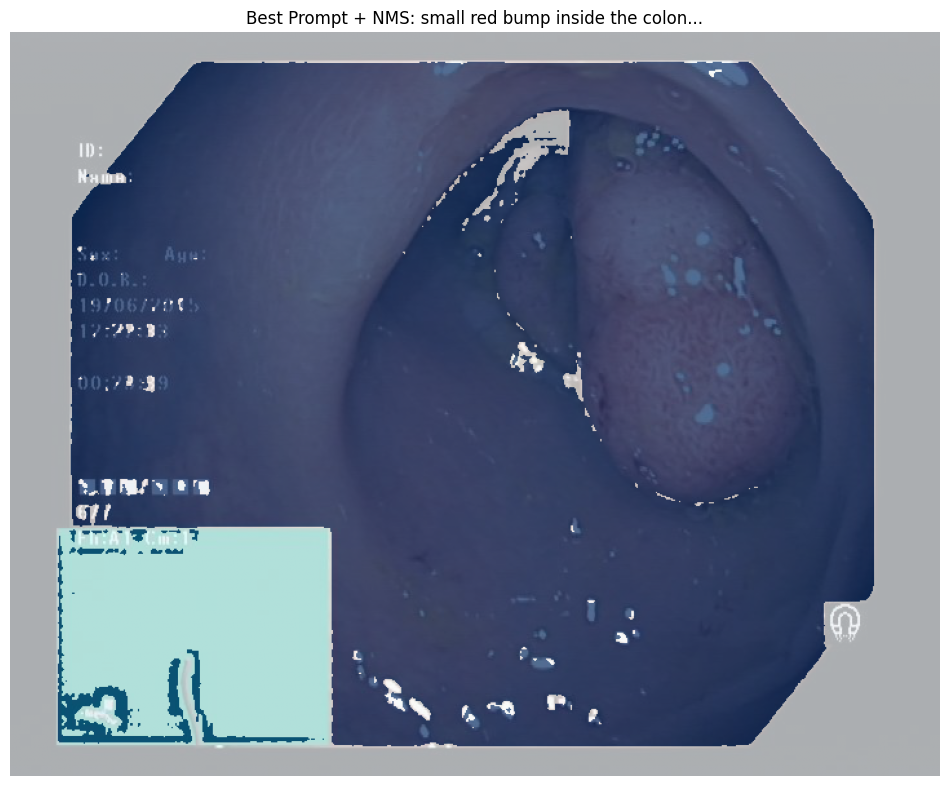

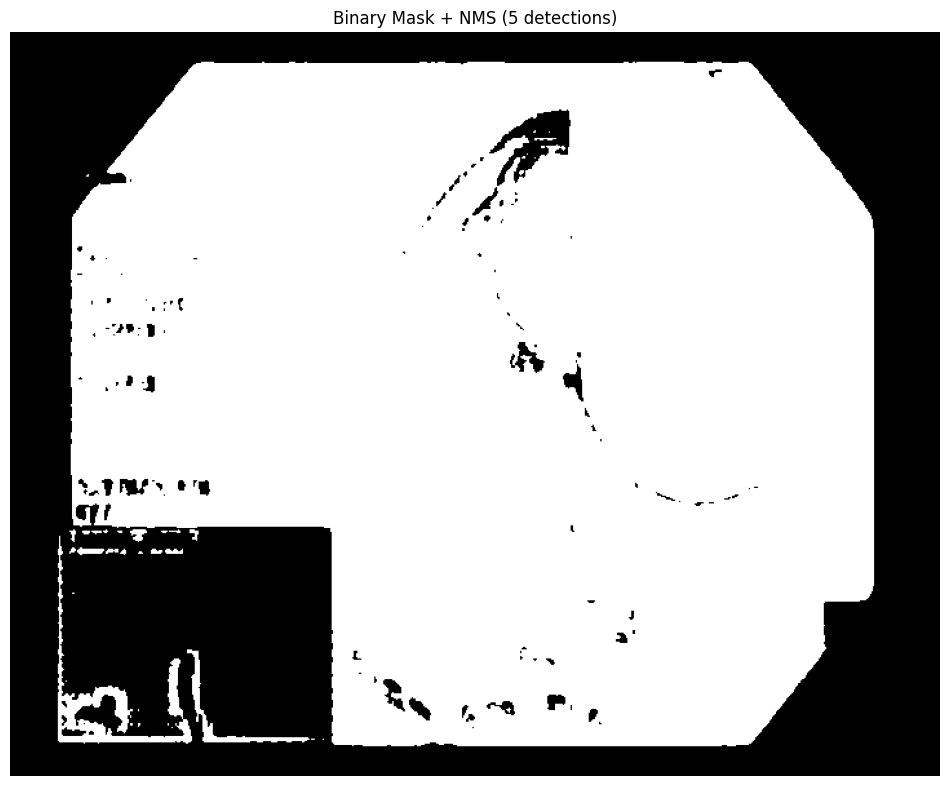

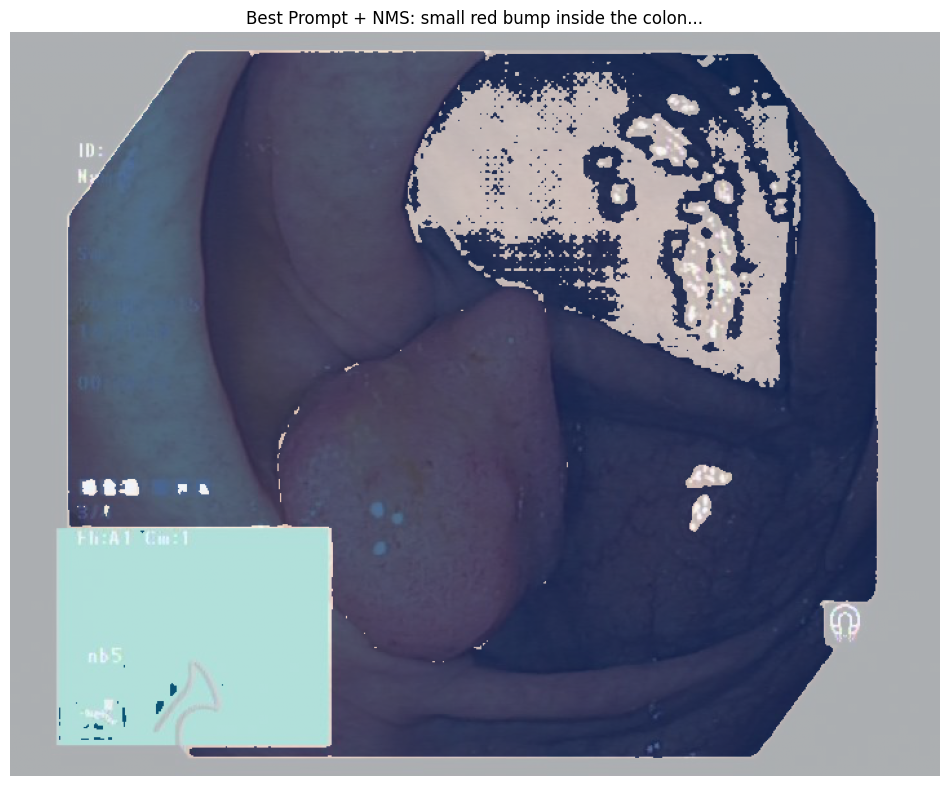

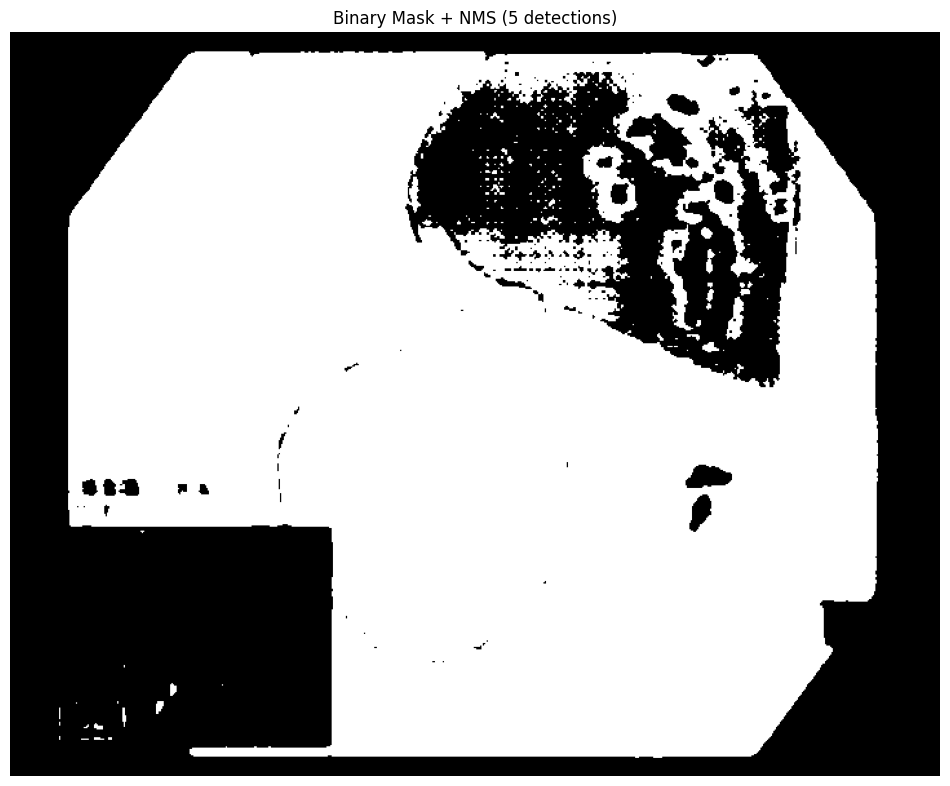

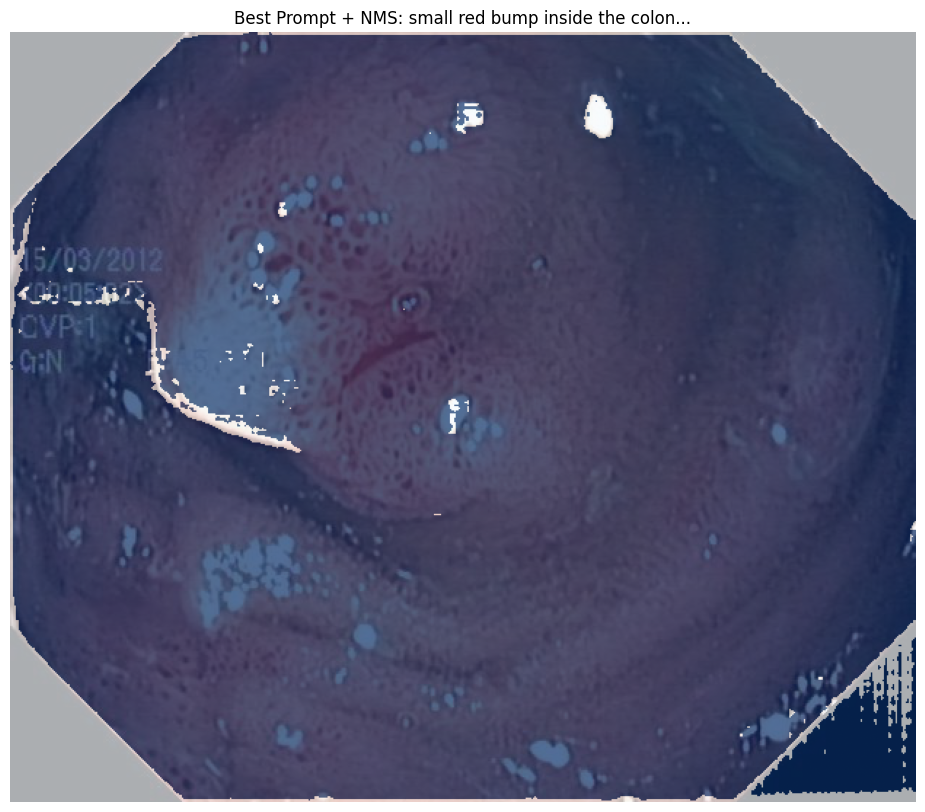

...

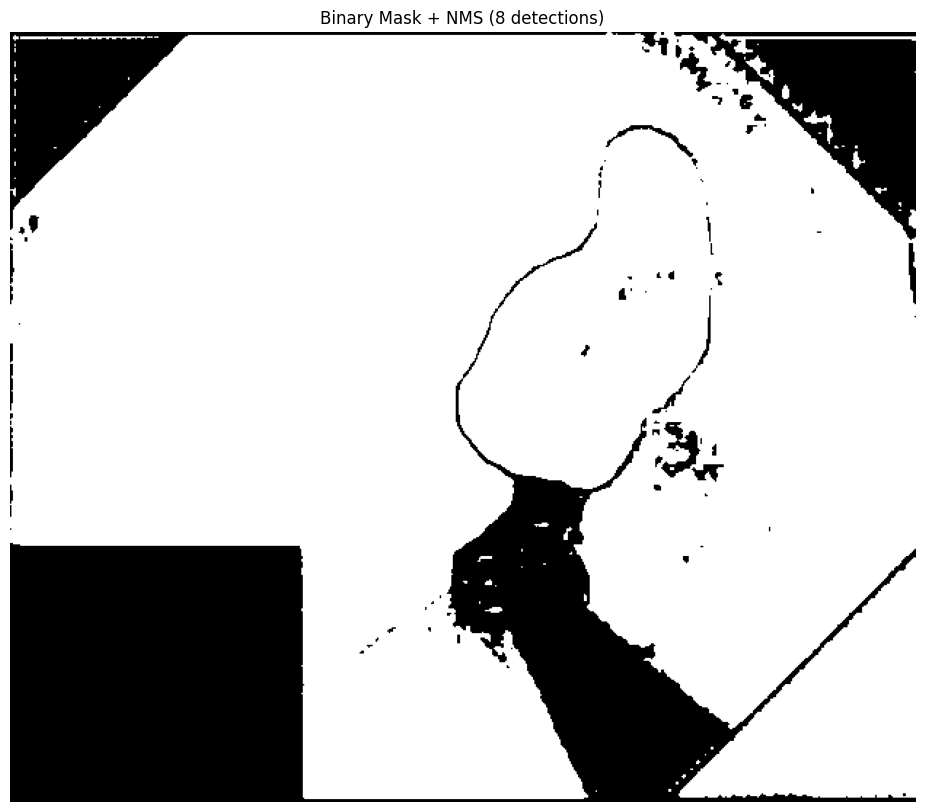

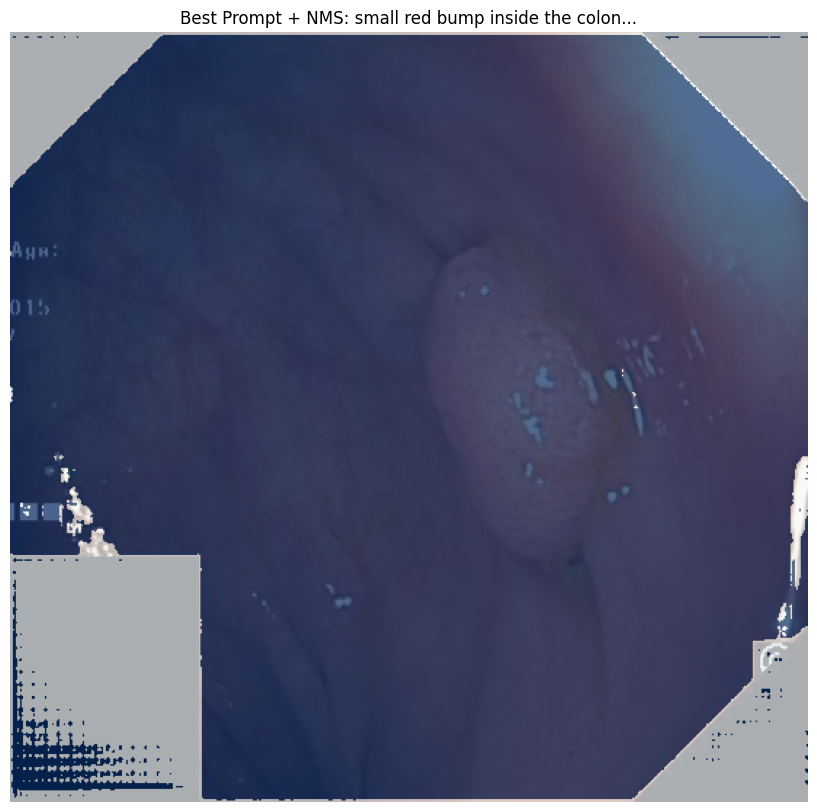

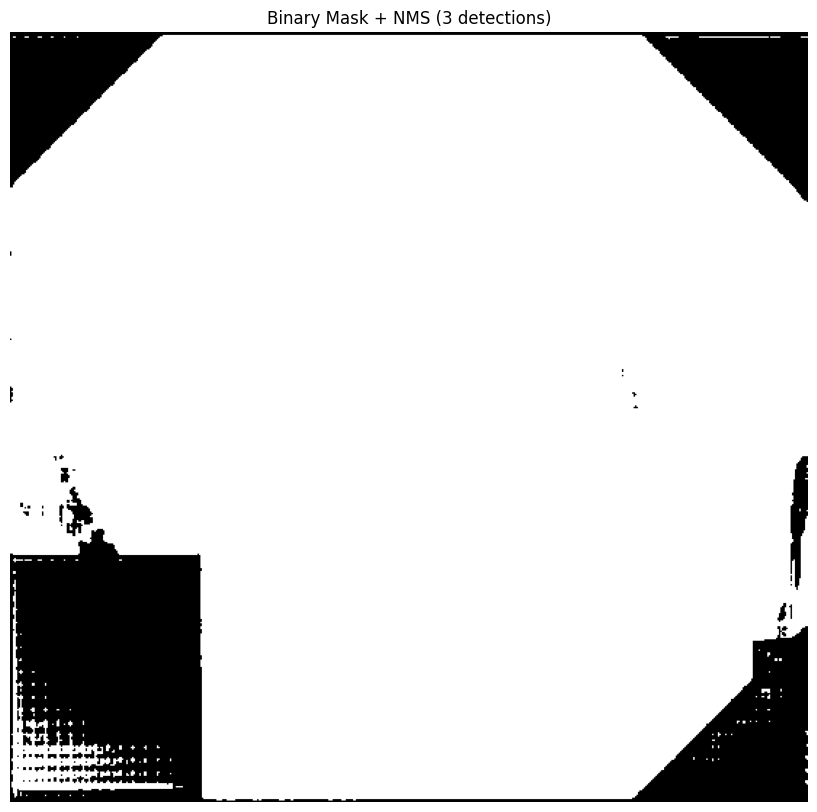

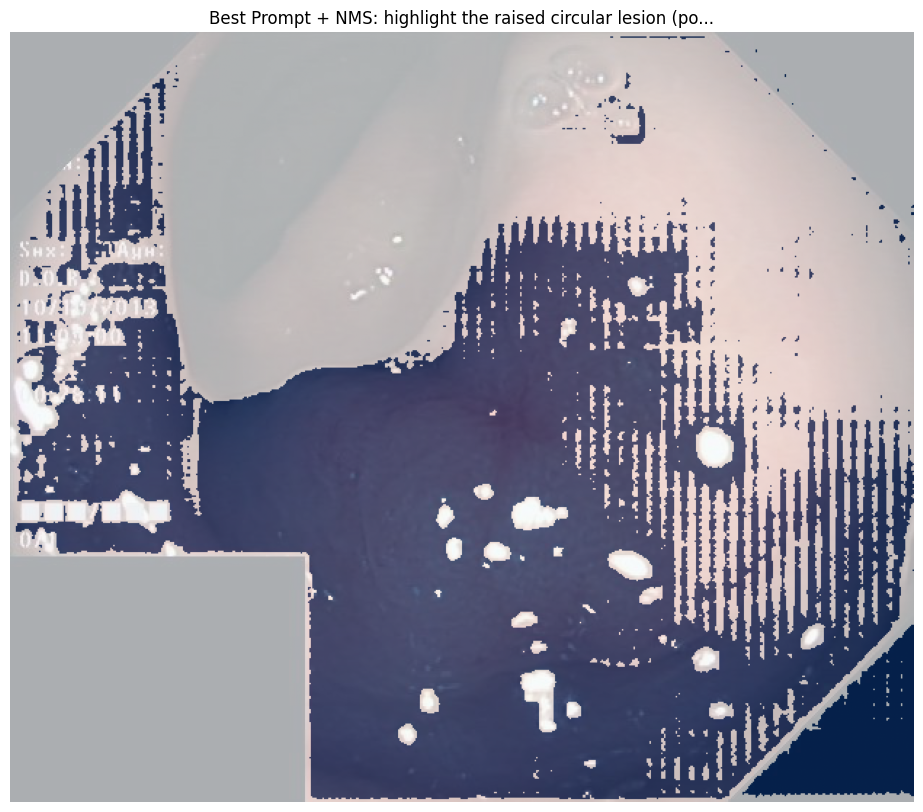

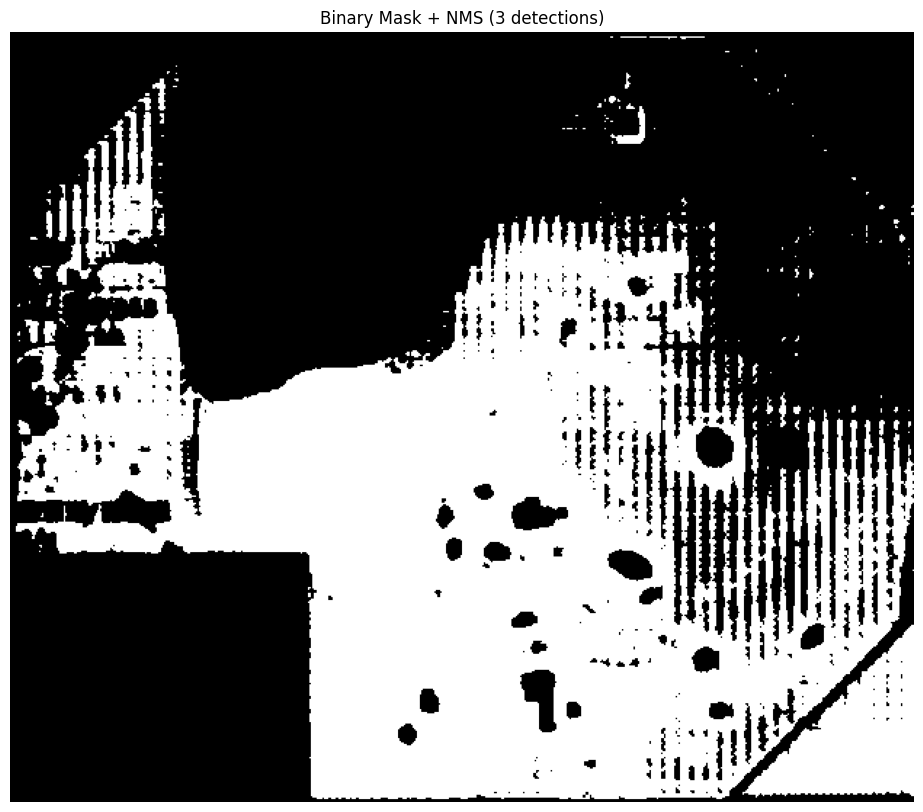

In [ ]:
#!/usr/bin/env python3
"""jun12 10:44
LangSAM-based polyp detection with outer box exclusion.
This version specifically removes the outer box rectangle that often appears in colonoscopy images.
"""

import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import cv2
from PIL import Image as PILImage
import torch
from torchvision.ops import nms
import warnings
warnings.filterwarnings('ignore')


MAX_BOX_AREA = 0.5 * 1920 * 1080  # Maximum box area threshold

# Text prompts optimized for polyp detection
TEXT_PROMPTS = [
    "highlight the raised circular lesion (polyp) inside the colon",
    "small red bump inside the colon",
    "soft tissue protrusion on colon lining",
    "irregular lump in colon view"
]

# Input/Output configuration
IMAGES_DIR = "/content/drive/MyDrive/val_images"
OUTPUT_DIR = "/content/drive/MyDrive/langsam_results_no_outerbox12_1100"
MAX_FILES = 20  # Process first 20 images for testing

# Detection thresholds
BOX_THRESHOLD = 0.15    # Object detection confidence
TEXT_THRESHOLD = 0.15   # Text-object association confidence
NMS_IOU_THRESHOLD = 0.4 # Non-Max Suppression IoU threshold

# Try to import LangSAM
try:
    from samgeo.text_sam import LangSAM
    LANGSAM_AVAILABLE = True
    print(" LangSAM is available!")
except ImportError:
    LANGSAM_AVAILABLE = False
    print("  LangSAM not available!")
    print(" Install with: pip install segment-geospatial groundingdino-py")
def remove_largest_box(boxes, scores=None, phrases=None):
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Compute area for each box
    areas = [(x2 - x1) * (y2 - y1) for (x1, y1, x2, y2) in boxes]
    largest_idx = np.argmax(areas)

    print(f"Removed largest box (area: {areas[largest_idx]:.1f}) — {len(boxes)-1} boxes remaining")

    # Remove the largest box
    boxes = np.delete(boxes, largest_idx, axis=0)
    if scores is not None:
        scores = np.delete(scores, largest_idx, axis=0)
    if phrases is not None:
        phrases = [phrases[i] for i in range(len(phrases)) if i != largest_idx]

    return boxes, scores, phrases

def is_outer_box(box, image_size, threshold=0.7, pixel_margin=10):
    h, w = image_size
    x1, y1, x2, y2 = box

    box_width = x2 - x1
    box_height = y2 - y1
    box_area = box_width * box_height
    image_area = h * w

    # Ratios
    width_ratio = box_width / w
    height_ratio = box_height / h

    # Pixel margin check
    near_left = x1 <= pixel_margin
    near_right = x2 >= (w - pixel_margin)
    near_top = y1 <= pixel_margin
    near_bottom = y2 >= (h - pixel_margin)
    near_all_edges = near_left and near_right and near_top and near_bottom

    # Area ratio
    area_ratio = box_area / image_area

    # Outer if: very large, or covers almost all the image, or touches all borders
    is_outer = (
        width_ratio > 0.90 and height_ratio > 0.90 or
        area_ratio > 0.90 or
        near_all_edges
    )

    # Debug print
    print(f"\nAnalyzing box:")
    print(f"  Size: {box_width:.1f}x{box_height:.1f} (Area: {box_area:.1f} pixels)")
    print(f"  Image size: {w}x{h}")
    print(f"  Width ratio: {width_ratio:.3f}")
    print(f"  Height ratio: {height_ratio:.3f}")
    print(f"  Area ratio: {area_ratio:.3f}")
    print(f"  Edges: left={near_left}, right={near_right}, top={near_top}, bottom={near_bottom}")
    print(f"  Final decision: {'Outer box' if is_outer else 'Inner box'}")

    return is_outer

def remove_outer_boxes(boxes, scores=None, phrases=None, image_size=None):
    """
    Remove boxes that are likely outer box rectangles.

    Args:
        boxes: List of [x1, y1, x2, y2] coordinates
        scores: Optional list of confidence scores
        phrases: Optional list of text phrases
        image_size: (height, width) of the image

    Returns:
        Filtered boxes, scores, and phrases
    """
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Convert to numpy arrays if needed
    boxes = np.array(boxes)
    if scores is not None:
        scores = np.array(scores)

    # Print debug information about all boxes
    print("\n Box Size Analysis:")
    print("="*50)
    h, w = image_size
    image_area = h * w
    print(f"Image dimensions: {w}x{h} (Area: {image_area} pixels)")
    print("\nAll detected boxes:")
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        area = width * height
        area_ratio = area / image_area
        print(f"Box {i+1}:")
        print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
        print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
        print(f"  Area ratio: {area_ratio:.3f}")
        if scores is not None:
            print(f"  Score: {scores[i]:.3f}")

    # Keep track of boxes to remove
    keep_indices = []

    print("\nAnalyzing outer boxes:")
    for i, box in enumerate(boxes):
        if not is_outer_box(box, image_size):
            keep_indices.append(i)
        else:
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1} identified as outer box:")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")

    # Filter results
    filtered_boxes = boxes[keep_indices]
    filtered_scores = scores[keep_indices] if scores is not None else None
    filtered_phrases = [phrases[i] for i in keep_indices] if phrases is not None else None

    removed_count = len(boxes) - len(filtered_boxes)
    if removed_count > 0:
        print(f"\n🧹 Removed {removed_count} outer box(es) — {len(filtered_boxes)} boxes remaining")

        # Print information about remaining boxes
        print("\nRemaining boxes:")
        for i, box in enumerate(filtered_boxes):
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1}:")
            print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")
            if filtered_scores is not None:
                print(f"  Score: {filtered_scores[i]:.3f}")

    return filtered_boxes, filtered_scores, filtered_phrases

def apply_nms_to_detections(boxes, scores=None, iou_threshold=0.4):
    """Apply Non-Max Suppression to filter overlapping detections."""
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, 0

    try:
        # Convert to torch tensors if not already
        if not isinstance(boxes, torch.Tensor):
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
        else:
            boxes_tensor = boxes.clone()

        # Handle scores
        if scores is not None:
            if not isinstance(scores, torch.Tensor):
                scores_tensor = torch.tensor(scores, dtype=torch.float32)
            else:
                scores_tensor = scores.clone()
        else:
            scores_tensor = torch.ones(len(boxes_tensor), dtype=torch.float32)

        # Apply NMS
        keep_indices = nms(boxes_tensor, scores_tensor, iou_threshold=iou_threshold)

        # Filter results
        filtered_boxes = boxes_tensor[keep_indices].numpy()
        filtered_scores = scores_tensor[keep_indices].numpy() if scores is not None else None

        return filtered_boxes, filtered_scores, len(boxes) - len(filtered_boxes)

    except Exception as e:
        print(f" NMS failed: {e}, using original detections")
        return boxes, scores, 0

def process_single_image_multi_prompts(image_path, text_prompts, sam_model):
    """Process a single image with multiple text prompts and combine results."""
    filename = Path(image_path).stem
    print(f"\nProcessing: {Path(image_path).name}")
    print(f"Testing {len(text_prompts)} text prompts...")

    try:
        # Load and prepare image
        image = PILImage.open(image_path).convert('RGB')
        image_size = image.size[::-1]  # (height, width)

        # Print image information
        print(f"\n Image Information:")
        print(f"Dimensions: {image_size[1]}x{image_size[0]} pixels")
        print(f"Total area: {image_size[0] * image_size[1]} pixels")

        # Save temporary image for LangSAM
        output_dir = Path(OUTPUT_DIR)
        output_dir.mkdir(exist_ok=True)
        temp_image_path = output_dir / f"{filename}_temp.jpg"
        image.save(temp_image_path)

        # Store all results from different prompts
        all_results = []
        successful_prompts = []
        total_boxes_before_nms = 0
        total_boxes_after_nms = 0

        # Run text-prompted segmentation for each prompt
        for i, text_prompt in enumerate(text_prompts, 1):
            try:
                print(f"  Prompt {i}/{len(text_prompts)}: '{text_prompt[:50]}{'...' if len(text_prompt) > 50 else ''}'")
                sam_model.predict(
                    str(temp_image_path),
                    text_prompt,
                    box_threshold=BOX_THRESHOLD,
                    text_threshold=TEXT_THRESHOLD
                )
                # Remove the largest box AFTER final prediction
                if hasattr(sam_model, 'boxes') and sam_model.boxes is not None and len(sam_model.boxes) > 1:
                  sam_model.boxes, sam_model.scores, _ = remove_largest_box(
                  sam_model.boxes,
                  sam_model.scores if hasattr(sam_model, 'scores') else None,
                  sam_model.phrases if hasattr(sam_model, 'phrases') else None
              )


                # Check if any detections were found
                if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
                    original_boxes = sam_model.boxes
                    original_scores = sam_model.scores if hasattr(sam_model, 'scores') else None

                    # Get image dimensions
                    img_width, img_height = image.size
                    img_area = img_width * img_height
                    AREA_THRESHOLD = 0.8 * img_area

                    # Filter out large boxes (> 80% of image area)
                    filtered_box_list = []
                    filtered_score_list = []

                    for idx, box in enumerate(original_boxes):
                        x1, y1, x2, y2 = box
                        box_area = (x2 - x1) * (y2 - y1)
                        if box_area <= AREA_THRESHOLD:
                            filtered_box_list.append(box)
                            if original_scores is not None:
                                filtered_score_list.append(original_scores[idx])

                    # If nothing remains, skip this prompt
                    if len(filtered_box_list) == 0:
                        print(f"      All boxes removed by area filter (>80% of image area)")
                        continue

                    # Convert to NumPy
                    filtered_boxes_np = np.array(filtered_box_list)
                    filtered_scores_np = np.array(filtered_score_list) if original_scores is not None else None
                    # ✅ Remove largest box if more than one remains
                    if len(filtered_box_list) > 1:
                        filtered_boxes_np, filtered_scores_np, _ = remove_largest_box(
                            filtered_boxes_np,
                            filtered_scores_np,
                            sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        )
                    # Apply NMS
                    filtered_boxes, filtered_scores, removed_count = apply_nms_to_detections(
                        filtered_boxes_np,
                        filtered_scores_np,
                        NMS_IOU_THRESHOLD
                    )

                    if len(filtered_boxes) > 0:
                        print(f"      🔍 NMS: {len(original_boxes)} → {len(filtered_boxes)} boxes (removed {removed_count} overlapping)")
                        # Update the model's attributes with filtered results
                        sam_model.boxes = filtered_boxes
                        if hasattr(sam_model, 'scores') and filtered_scores is not None:
                            sam_model.scores = filtered_scores

                        all_results.append({
                            'prompt': text_prompt,
                            'boxes': filtered_boxes,
                            'original_boxes': original_boxes,
                            'boxes_removed': removed_count,
                            'masks': sam_model.masks if hasattr(sam_model, 'masks') else None,
                            'phrases': sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        })
                        successful_prompts.append(text_prompt)
                        total_boxes_before_nms += len(original_boxes)
                        total_boxes_after_nms += len(filtered_boxes)
                        print(f"     Found {len(filtered_boxes)} detection(s) after NMS")
                    else:
                        print(f"     All boxes removed by NMS")
                else:
                    print(f"        No detections found")
            except Exception as e:
                print(f"        Error with prompt: {e}")
                continue

        if not all_results:
            print(f"  No polyps detected with any prompt for {Path(image_path).name}")
            return False

        print(f"Successfully detected polyps with {len(successful_prompts)}/{len(text_prompts)} prompts")
        print(f"NMS Summary: {total_boxes_before_nms} → {total_boxes_after_nms} total boxes (removed {total_boxes_before_nms - total_boxes_after_nms} overlapping)")

               # Use the best result (most detections) for final output
        best_result = max(all_results, key=lambda x: len(x['boxes']) if x['boxes'] is not None else 0)
        print(f"Final selected prompt has {len(best_result['boxes'])} boxes")

        best_prompt = best_result['prompt']

        print(f"Best result from: '{best_prompt[:50]}{'...' if len(best_prompt) > 50 else ''}' ({len(best_result['boxes'])} detections)")

        # Reuse best_result instead of rerunning predict()
        sam_model.boxes = best_result['boxes']
        sam_model.scores = best_result['scores'] if 'scores' in best_result else None
        sam_model.masks = best_result['masks'] if 'masks' in best_result else None

        sam_model.phrases = best_result['phrases']

        # Apply NMS to final result
        if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
            filtered_boxes, filtered_scores, _ = apply_nms_to_detections(
                sam_model.boxes,
                sam_model.scores if hasattr(sam_model, 'scores') else None,
                NMS_IOU_THRESHOLD
            )
            sam_model.boxes = filtered_boxes
            if hasattr(sam_model, 'scores') and filtered_scores is not None:
                sam_model.scores = filtered_scores

        # Save results
        try:
            # Create visualization with bounding boxes
            bbox_output = output_dir / f"{filename}_with_boxes.png"

            # Load original image
            img_with_boxes = cv2.imread(str(image_path))
            if img_with_boxes is None:
                img_with_boxes = np.array(image)
            else:
                img_with_boxes = cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB)

            # Draw bounding boxes and save masks
            for i, box in enumerate(best_result['boxes']):
                x1, y1, x2, y2 = [int(coord) for coord in box]
                annotated_img = img_with_boxes.copy()

                # Draw rectangle
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (255, 0, 0), 3)

                # Draw score (optional)
                score = sam_model.scores[i] if sam_model.scores is not None else None
                if score is not None:
                    cv2.putText(annotated_img, f'{score:.2f}', (x1, y1 - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

                # Save image with box
                per_box_output = output_dir / f"{filename}_box{i+1}.png"
                plt.figure(figsize=(10, 7))
                plt.imshow(annotated_img)
                plt.title(f"Box {i+1} (Score: {score:.2f}) — Prompt: {best_prompt[:40]}..." if score else f"Box {i+1}")
                plt.axis('off')
                plt.tight_layout()
                plt.savefig(per_box_output, dpi=150, bbox_inches='tight')
                plt.close()
                print(f"  🖼️ Saved: {per_box_output}")

                # Save binary mask
                if best_result['masks'] is not None and i < len(best_result['masks']):

                    mask = best_result['masks'][i]
                    if isinstance(mask, torch.Tensor):
                        mask = mask.cpu().numpy()  # Convert to NumPy
                    mask_output = output_dir / f"{filename}_mask{i+1}.png"
                    plt.imsave(mask_output, mask.astype(np.uint8) * 255, cmap='gray')

                    print(f"  💾 Saved mask: {mask_output}")
                else:
                    print(f"  ⚠️ No mask found for box {i+1}")




            # Save mask visualization
            try:
                mask_output = output_dir / f"{filename}_mask_only.png"
                sam_model.show_anns(
                    cmap="Blues",
                    add_boxes=False,
                    alpha=0.7,
                    title=f"Best Prompt + NMS: {best_prompt[:40]}...",
                    output=str(mask_output)
                )
                print(f"  Saved: {mask_output}")
            except Exception as e:
                print(f"   Warning: Could not save mask image ({e})")
                mask_output = None

            # Save binary mask
            try:
                binary_output = output_dir / f"{filename}_binary.png"

                # Try to create binary mask manually if show_anns fails
                try:
                    sam_model.show_anns(
                        cmap="Greys_r",
                        add_boxes=False,
                        alpha=1,
                        title=f"Binary Mask + NMS ({len(best_result['boxes'])} detections)",
                        blend=False,
                        output=str(binary_output)
                    )
                    print(f"  Saved: {binary_output}")
                except Exception as mask_error:
                    print(f" LangSAM binary save failed ({mask_error}), trying manual approach...")

                    # Manual binary mask creation
                    if hasattr(sam_model, 'masks') and sam_model.masks is not None:
                        # Convert masks to proper format
                        combined_mask = np.zeros((image.height, image.width), dtype=np.uint8)
                        for mask in sam_model.masks:
                            if hasattr(mask, 'shape'):
                                mask_array = np.array(mask, dtype=np.uint8)
                                if mask_array.shape[:2] == combined_mask.shape:
                                    combined_mask = np.logical_or(combined_mask, mask_array).astype(np.uint8)

                        # Save manually created binary mask
                        plt.figure(figsize=(10, 8))
                        plt.imshow(combined_mask * 255, cmap='gray')
                        plt.title(f"Binary Mask + NMS ({len(best_result['boxes'])} detections)")
                        plt.axis('off')
                        plt.tight_layout()
                        plt.savefig(binary_output, dpi=150, bbox_inches='tight')
                        plt.close()
                        print(f"  Saved (manual): {binary_output}")
                    else:
                        print(f"  No masks available for binary image")
                        binary_output = None

            except Exception as e:
                print(f"    Warning: Could not save binary image ({e})")
                binary_output = None

            # Save prompt analysis results
            analysis_file = output_dir / f"{filename}_prompt_analysis.txt"
            with open(analysis_file, 'w') as f:
                f.write(f"Multi-Prompt Analysis + NMS for {filename}\n")
                f.write("="*50 + "\n\n")
                f.write(f"Architecture: LangSAM + Non-Max Suppression\n")
                f.write(f"NMS IoU threshold: {NMS_IOU_THRESHOLD}\n")
                f.write(f"Total prompts tested: {len(text_prompts)}\n")
                f.write(f"Successful prompts: {len(successful_prompts)}\n")
                f.write(f"Best prompt: {best_prompt}\n")
                f.write(f"Best prompt detections: {len(best_result['boxes'])}\n")
                f.write(f"Total boxes before NMS: {total_boxes_before_nms}\n")
                f.write(f"Total boxes after NMS: {total_boxes_after_nms}\n")
                f.write(f"Boxes removed by NMS: {total_boxes_before_nms - total_boxes_after_nms}\n\n")
                f.write("Prompt Results:\n")
                for result in all_results:
                    f.write(f"- '{result['prompt']}': {len(result['original_boxes'])} → {len(result['boxes'])} detections (removed {result['boxes_removed']})\n")

            print(f"  Analysis: {analysis_file}")

        except Exception as e:
            print(f"  Warning: Could not save results ({e})")
        print(f"Total boxes saved for {filename}: {len(best_result['boxes'])}")

        # Clean up temp file
        try:
            if temp_image_path.exists():
                temp_image_path.unlink()
                print(f"   🗑️  Cleaned up temp file")
        except Exception as cleanup_error:
            print(f"   Could not clean up temp file: {cleanup_error}")

        return True

    except Exception as e:
        print(f"  Error processing {Path(image_path).name}: {e}")
        return False

def main():
    """Main function to run the LangSAM polyp detection."""
    if not LANGSAM_AVAILABLE:
        print("  LangSAM not available. Please install required packages.")
        return

    print("\n" + "="*60)
    print("MEDICAL TEXT PROMPT SEGMENTATION + NMS")
    print(f"Text Prompts: {len(TEXT_PROMPTS)} prompts")
    for i, prompt in enumerate(TEXT_PROMPTS, 1):
        print(f"   {i}. '{prompt}'")
    print("Technology: LangSAM (GroundingDINO + SAM) + Non-Max Suppression")
    print(f" NMS IoU Threshold: {NMS_IOU_THRESHOLD}")
    print("="*60)

    try:
        # Initialize LangSAM
        print("\n🤖Initializing LangSAM (this may take a few minutes)...")
        print(" Downloading model weights if not already cached...")

        sam = LangSAM(model_type="vit_b")
        print("LangSAM initialized successfully with vit_b model!")

        # Process images
        if not os.path.exists(IMAGES_DIR):
            print(f"  Images directory not found: {IMAGES_DIR}")
            return

        images_dir = Path(IMAGES_DIR)
        jpg_files = list(images_dir.glob("*.jpg")) + list(images_dir.glob("*.jpeg"))

        print(f" Found {len(jpg_files)} total JPG files")

        if MAX_FILES and MAX_FILES > 0:
            jpg_files = jpg_files[:MAX_FILES]
            print(f" Limited to first {len(jpg_files)} files")

        if not jpg_files:
            print(f"  No JPG images found in {IMAGES_DIR}")
            return

        print(f"\n Processing {len(jpg_files)} images with {len(TEXT_PROMPTS)} text prompts each + NMS")

        successful = 0
        failed = 0

        for i, image_path in enumerate(jpg_files, 1):
            print(f"\n{'='*50}")
            print(f"📷Processing {i}/{len(jpg_files)}: {image_path.name}")

            if process_single_image_multi_prompts(image_path, TEXT_PROMPTS, sam):
                successful += 1
            else:
                failed += 1

        print(f"\n{'='*50}")
        print(f" BATCH PROCESSING SUMMARY:")
        print(f" Successful: {successful}")
        print(f"  Failed: {failed}")
        print(f" Results saved to: {OUTPUT_DIR}")
        print(f" Total prompt combinations tested: {len(jpg_files)} × {len(TEXT_PROMPTS)} = {len(jpg_files) * len(TEXT_PROMPTS)}")
        print(f" Architecture: LangSAM (GroundingDINO + SAM) + NMS (IoU={NMS_IOU_THRESHOLD})")

    except Exception as e:
        print(f"  Error initializing LangSAM: {e}")
        print(" This could be due to:")
        print("   • Version compatibility issues")
        print("   • Missing dependencies")
        print("   • Model download failures")
        print("\n  Try these fixes:")
        print("   1. Reinstall dependencies:")
        print("      pip uninstall segment-geospatial groundingdino-py -y")
        print("      pip install segment-geospatial==0.10.2")
        print("   2. Clear model cache and restart kernel")
        print("   3. Use different Python environment")

if __name__ == "__main__":
    main()

OLDER

In [ ]:
#!/usr/bin/env python3
"""jun12 9:06
LangSAM-based polyp detection with outer box exclusion.
This version specifically removes the outer box rectangle that often appears in colonoscopy images.
"""

import os
import sys
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import cv2
from PIL import Image as PILImage
import torch
from torchvision.ops import nms
import warnings
warnings.filterwarnings('ignore')


MAX_BOX_AREA = 0.5 * 1920 * 1080  # Maximum box area threshold

# Text prompts optimized for polyp detection
TEXT_PROMPTS = [
    "highlight the raised circular lesion (polyp) inside the colon",
    "small red bump inside the colon",
    "soft tissue protrusion on colon lining",
    "irregular lump in colon view"
]

# Input/Output configuration
IMAGES_DIR = "/content/drive/MyDrive/val_images"
OUTPUT_DIR = "/content/drive/MyDrive/langsam_results_no_outerbox12_905"
MAX_FILES = 20  # Process first 20 images for testing

# Detection thresholds
BOX_THRESHOLD = 0.15    # Object detection confidence
TEXT_THRESHOLD = 0.15   # Text-object association confidence
NMS_IOU_THRESHOLD = 0.4 # Non-Max Suppression IoU threshold

# Try to import LangSAM
try:
    from samgeo.text_sam import LangSAM
    LANGSAM_AVAILABLE = True
    print(" LangSAM is available!")
except ImportError:
    LANGSAM_AVAILABLE = False
    print("  LangSAM not available!")
    print(" Install with: pip install segment-geospatial groundingdino-py")
def remove_largest_box(boxes, scores=None, phrases=None):
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Compute area for each box
    areas = [(x2 - x1) * (y2 - y1) for (x1, y1, x2, y2) in boxes]
    largest_idx = np.argmax(areas)

    print(f"Removed largest box (area: {areas[largest_idx]:.1f}) — {len(boxes)-1} boxes remaining")

    # Remove the largest box
    boxes = np.delete(boxes, largest_idx, axis=0)
    if scores is not None:
        scores = np.delete(scores, largest_idx, axis=0)
    if phrases is not None:
        phrases = [phrases[i] for i in range(len(phrases)) if i != largest_idx]

    return boxes, scores, phrases

def is_outer_box(box, image_size, threshold=0.7, pixel_margin=10):
    h, w = image_size
    x1, y1, x2, y2 = box

    box_width = x2 - x1
    box_height = y2 - y1
    box_area = box_width * box_height
    image_area = h * w

    # Ratios
    width_ratio = box_width / w
    height_ratio = box_height / h

    # Pixel margin check
    near_left = x1 <= pixel_margin
    near_right = x2 >= (w - pixel_margin)
    near_top = y1 <= pixel_margin
    near_bottom = y2 >= (h - pixel_margin)
    near_all_edges = near_left and near_right and near_top and near_bottom

    # Area ratio
    area_ratio = box_area / image_area

    # Outer if: very large, or covers almost all the image, or touches all borders
    is_outer = (
        width_ratio > 0.90 and height_ratio > 0.90 or
        area_ratio > 0.90 or
        near_all_edges
    )

    # Debug print
    print(f"\nAnalyzing box:")
    print(f"  Size: {box_width:.1f}x{box_height:.1f} (Area: {box_area:.1f} pixels)")
    print(f"  Image size: {w}x{h}")
    print(f"  Width ratio: {width_ratio:.3f}")
    print(f"  Height ratio: {height_ratio:.3f}")
    print(f"  Area ratio: {area_ratio:.3f}")
    print(f"  Edges: left={near_left}, right={near_right}, top={near_top}, bottom={near_bottom}")
    print(f"  Final decision: {'Outer box' if is_outer else 'Inner box'}")

    return is_outer

def remove_outer_boxes(boxes, scores=None, phrases=None, image_size=None):
    """
    Remove boxes that are likely outer box rectangles.

    Args:
        boxes: List of [x1, y1, x2, y2] coordinates
        scores: Optional list of confidence scores
        phrases: Optional list of text phrases
        image_size: (height, width) of the image

    Returns:
        Filtered boxes, scores, and phrases
    """
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, phrases

    # Convert to numpy arrays if needed
    boxes = np.array(boxes)
    if scores is not None:
        scores = np.array(scores)

    # Print debug information about all boxes
    print("\n Box Size Analysis:")
    print("="*50)
    h, w = image_size
    image_area = h * w
    print(f"Image dimensions: {w}x{h} (Area: {image_area} pixels)")
    print("\nAll detected boxes:")
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = box
        width = x2 - x1
        height = y2 - y1
        area = width * height
        area_ratio = area / image_area
        print(f"Box {i+1}:")
        print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
        print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
        print(f"  Area ratio: {area_ratio:.3f}")
        if scores is not None:
            print(f"  Score: {scores[i]:.3f}")

    # Keep track of boxes to remove
    keep_indices = []

    print("\nAnalyzing outer boxes:")
    for i, box in enumerate(boxes):
        if not is_outer_box(box, image_size):
            keep_indices.append(i)
        else:
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1} identified as outer box:")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")

    # Filter results
    filtered_boxes = boxes[keep_indices]
    filtered_scores = scores[keep_indices] if scores is not None else None
    filtered_phrases = [phrases[i] for i in keep_indices] if phrases is not None else None

    removed_count = len(boxes) - len(filtered_boxes)
    if removed_count > 0:
        print(f"\n🧹 Removed {removed_count} outer box(es) — {len(filtered_boxes)} boxes remaining")

        # Print information about remaining boxes
        print("\nRemaining boxes:")
        for i, box in enumerate(filtered_boxes):
            x1, y1, x2, y2 = box
            width = x2 - x1
            height = y2 - y1
            area = width * height
            area_ratio = area / image_area
            print(f"Box {i+1}:")
            print(f"  Position: ({x1:.1f}, {y1:.1f}) to ({x2:.1f}, {y2:.1f})")
            print(f"  Size: {width:.1f}x{height:.1f} (Area: {area:.1f} pixels)")
            print(f"  Area ratio: {area_ratio:.3f}")
            if filtered_scores is not None:
                print(f"  Score: {filtered_scores[i]:.3f}")

    return filtered_boxes, filtered_scores, filtered_phrases

def apply_nms_to_detections(boxes, scores=None, iou_threshold=0.4):
    """Apply Non-Max Suppression to filter overlapping detections."""
    if boxes is None or len(boxes) <= 1:
        return boxes, scores, 0

    try:
        # Convert to torch tensors if not already
        if not isinstance(boxes, torch.Tensor):
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
        else:
            boxes_tensor = boxes.clone()

        # Handle scores
        if scores is not None:
            if not isinstance(scores, torch.Tensor):
                scores_tensor = torch.tensor(scores, dtype=torch.float32)
            else:
                scores_tensor = scores.clone()
        else:
            scores_tensor = torch.ones(len(boxes_tensor), dtype=torch.float32)

        # Apply NMS
        keep_indices = nms(boxes_tensor, scores_tensor, iou_threshold=iou_threshold)

        # Filter results
        filtered_boxes = boxes_tensor[keep_indices].numpy()
        filtered_scores = scores_tensor[keep_indices].numpy() if scores is not None else None

        return filtered_boxes, filtered_scores, len(boxes) - len(filtered_boxes)

    except Exception as e:
        print(f" NMS failed: {e}, using original detections")
        return boxes, scores, 0

def process_single_image_multi_prompts(image_path, text_prompts, sam_model):
    """Process a single image with multiple text prompts and combine results."""
    filename = Path(image_path).stem
    print(f"\nProcessing: {Path(image_path).name}")
    print(f"Testing {len(text_prompts)} text prompts...")

    try:
        # Load and prepare image
        image = PILImage.open(image_path).convert('RGB')
        image_size = image.size[::-1]  # (height, width)

        # Print image information
        print(f"\n Image Information:")
        print(f"Dimensions: {image_size[1]}x{image_size[0]} pixels")
        print(f"Total area: {image_size[0] * image_size[1]} pixels")

        # Save temporary image for LangSAM
        output_dir = Path(OUTPUT_DIR)
        output_dir.mkdir(exist_ok=True)
        temp_image_path = output_dir / f"{filename}_temp.jpg"
        image.save(temp_image_path)

        # Store all results from different prompts
        all_results = []
        successful_prompts = []
        total_boxes_before_nms = 0
        total_boxes_after_nms = 0

        # Run text-prompted segmentation for each prompt
        for i, text_prompt in enumerate(text_prompts, 1):
            try:
                print(f"  Prompt {i}/{len(text_prompts)}: '{text_prompt[:50]}{'...' if len(text_prompt) > 50 else ''}'")
                sam_model.predict(
                    str(temp_image_path),
                    text_prompt,
                    box_threshold=BOX_THRESHOLD,
                    text_threshold=TEXT_THRESHOLD
                )
                # Remove the largest box AFTER final prediction
                if hasattr(sam_model, 'boxes') and sam_model.boxes is not None and len(sam_model.boxes) > 1:
                  sam_model.boxes, sam_model.scores, _ = remove_largest_box(
                  sam_model.boxes,
                  sam_model.scores if hasattr(sam_model, 'scores') else None,
                  sam_model.phrases if hasattr(sam_model, 'phrases') else None
              )


                # Check if any detections were found
                if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
                    original_boxes = sam_model.boxes
                    original_scores = sam_model.scores if hasattr(sam_model, 'scores') else None

                    # Get image dimensions
                    img_width, img_height = image.size
                    img_area = img_width * img_height
                    AREA_THRESHOLD = 0.8 * img_area

                    # Filter out large boxes (> 80% of image area)
                    filtered_box_list = []
                    filtered_score_list = []

                    for idx, box in enumerate(original_boxes):
                        x1, y1, x2, y2 = box
                        box_area = (x2 - x1) * (y2 - y1)
                        if box_area <= AREA_THRESHOLD:
                            filtered_box_list.append(box)
                            if original_scores is not None:
                                filtered_score_list.append(original_scores[idx])

                    # If nothing remains, skip this prompt
                    if len(filtered_box_list) == 0:
                        print(f"      All boxes removed by area filter (>80% of image area)")
                        continue

                    # Convert to NumPy
                    filtered_boxes_np = np.array(filtered_box_list)
                    filtered_scores_np = np.array(filtered_score_list) if original_scores is not None else None
                    # ✅ Remove largest box if more than one remains
                    if len(filtered_box_list) > 1:
                        filtered_boxes_np, filtered_scores_np, _ = remove_largest_box(
                            filtered_boxes_np,
                            filtered_scores_np,
                            sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        )
                    # Apply NMS
                    filtered_boxes, filtered_scores, removed_count = apply_nms_to_detections(
                        filtered_boxes_np,
                        filtered_scores_np,
                        NMS_IOU_THRESHOLD
                    )

                    if len(filtered_boxes) > 0:
                        print(f"      🔍 NMS: {len(original_boxes)} → {len(filtered_boxes)} boxes (removed {removed_count} overlapping)")
                        # Update the model's attributes with filtered results
                        sam_model.boxes = filtered_boxes
                        if hasattr(sam_model, 'scores') and filtered_scores is not None:
                            sam_model.scores = filtered_scores

                        all_results.append({
                            'prompt': text_prompt,
                            'boxes': filtered_boxes,
                            'original_boxes': original_boxes,
                            'boxes_removed': removed_count,
                            'masks': sam_model.masks if hasattr(sam_model, 'masks') else None,
                            'phrases': sam_model.phrases if hasattr(sam_model, 'phrases') else None
                        })
                        successful_prompts.append(text_prompt)
                        total_boxes_before_nms += len(original_boxes)
                        total_boxes_after_nms += len(filtered_boxes)
                        print(f"     Found {len(filtered_boxes)} detection(s) after NMS")
                    else:
                        print(f"     All boxes removed by NMS")
                else:
                    print(f"        No detections found")
            except Exception as e:
                print(f"        Error with prompt: {e}")
                continue

        if not all_results:
            print(f"  No polyps detected with any prompt for {Path(image_path).name}")
            return False

        print(f"Successfully detected polyps with {len(successful_prompts)}/{len(text_prompts)} prompts")
        print(f"NMS Summary: {total_boxes_before_nms} → {total_boxes_after_nms} total boxes (removed {total_boxes_before_nms - total_boxes_after_nms} overlapping)")

               # Use the best result (most detections) for final output
        best_result = max(all_results, key=lambda x: len(x['boxes']) if x['boxes'] is not None else 0)
        best_prompt = best_result['prompt']

        print(f"Best result from: '{best_prompt[:50]}{'...' if len(best_prompt) > 50 else ''}' ({len(best_result['boxes'])} detections)")

        # Reuse best_result instead of rerunning predict()
        sam_model.boxes = best_result['boxes']
        sam_model.scores = None
        sam_model.masks = best_result['masks']
        sam_model.phrases = best_result['phrases']

        # Apply NMS to final result
        if hasattr(sam_model, 'boxes') and len(sam_model.boxes) > 0:
            filtered_boxes, filtered_scores, _ = apply_nms_to_detections(
                sam_model.boxes,
                sam_model.scores if hasattr(sam_model, 'scores') else None,
                NMS_IOU_THRESHOLD
            )
            sam_model.boxes = filtered_boxes
            if hasattr(sam_model, 'scores') and filtered_scores is not None:
                sam_model.scores = filtered_scores

        # Save results
        try:
            # Create visualization with bounding boxes
            bbox_output = output_dir / f"{filename}_with_boxes.png"

            # Load original image
            img_with_boxes = cv2.imread(str(image_path))
            if img_with_boxes is None:
                img_with_boxes = np.array(image)
            else:
                img_with_boxes = cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB)

            # Draw bounding boxes and save masks
            for i, box in enumerate(best_result['boxes']):
                x1, y1, x2, y2 = [int(coord) for coord in box]
                annotated_img = img_with_boxes.copy()

                # Draw rectangle
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (255, 0, 0), 3)

                # Draw score (optional)
                score = sam_model.scores[i] if sam_model.scores is not None else None
                if score is not None:
                    cv2.putText(annotated_img, f'{score:.2f}', (x1, y1 - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

                # Save image with box
                per_box_output = output_dir / f"{filename}_box{i+1}.png"
                plt.figure(figsize=(10, 7))
                plt.imshow(annotated_img)
                plt.title(f"Box {i+1} (Score: {score:.2f}) — Prompt: {best_prompt[:40]}..." if score else f"Box {i+1}")
                plt.axis('off')
                plt.tight_layout()
                plt.savefig(per_box_output, dpi=150, bbox_inches='tight')
                plt.close()
                print(f"  🖼️ Saved: {per_box_output}")

                # Save binary mask
                if best_result['masks'] is not None and len(best_result['masks']) > i:
                    mask = best_result['masks'][i]
                    mask_output = output_dir / f"{filename}_mask{i+1}.png"
                    plt.imsave(mask_output, mask.astype(np.uint8) * 255, cmap='gray')
                    print(f"  💾 Saved mask: {mask_output}")
                else:
                    print(f"  ⚠️ No mask found for box {i+1}")




            # Save mask visualization
            try:
                mask_output = output_dir / f"{filename}_mask_only.png"
                sam_model.show_anns(
                    cmap="Blues",
                    add_boxes=False,
                    alpha=0.7,
                    title=f"Best Prompt + NMS: {best_prompt[:40]}...",
                    output=str(mask_output)
                )
                print(f"  Saved: {mask_output}")
            except Exception as e:
                print(f"   Warning: Could not save mask image ({e})")
                mask_output = None

            # Save binary mask
            try:
                binary_output = output_dir / f"{filename}_binary.png"

                # Try to create binary mask manually if show_anns fails
                try:
                    sam_model.show_anns(
                        cmap="Greys_r",
                        add_boxes=False,
                        alpha=1,
                        title=f"Binary Mask + NMS ({len(best_result['boxes'])} detections)",
                        blend=False,
                        output=str(binary_output)
                    )
                    print(f"  Saved: {binary_output}")
                except Exception as mask_error:
                    print(f" LangSAM binary save failed ({mask_error}), trying manual approach...")

                    # Manual binary mask creation
                    if hasattr(sam_model, 'masks') and sam_model.masks is not None:
                        # Convert masks to proper format
                        combined_mask = np.zeros((image.height, image.width), dtype=np.uint8)
                        for mask in sam_model.masks:
                            if hasattr(mask, 'shape'):
                                mask_array = np.array(mask, dtype=np.uint8)
                                if mask_array.shape[:2] == combined_mask.shape:
                                    combined_mask = np.logical_or(combined_mask, mask_array).astype(np.uint8)

                        # Save manually created binary mask
                        plt.figure(figsize=(10, 8))
                        plt.imshow(combined_mask * 255, cmap='gray')
                        plt.title(f"Binary Mask + NMS ({len(best_result['boxes'])} detections)")
                        plt.axis('off')
                        plt.tight_layout()
                        plt.savefig(binary_output, dpi=150, bbox_inches='tight')
                        plt.close()
                        print(f"  Saved (manual): {binary_output}")
                    else:
                        print(f"  No masks available for binary image")
                        binary_output = None

            except Exception as e:
                print(f"    Warning: Could not save binary image ({e})")
                binary_output = None

            # Save prompt analysis results
            analysis_file = output_dir / f"{filename}_prompt_analysis.txt"
            with open(analysis_file, 'w') as f:
                f.write(f"Multi-Prompt Analysis + NMS for {filename}\n")
                f.write("="*50 + "\n\n")
                f.write(f"Architecture: LangSAM + Non-Max Suppression\n")
                f.write(f"NMS IoU threshold: {NMS_IOU_THRESHOLD}\n")
                f.write(f"Total prompts tested: {len(text_prompts)}\n")
                f.write(f"Successful prompts: {len(successful_prompts)}\n")
                f.write(f"Best prompt: {best_prompt}\n")
                f.write(f"Best prompt detections: {len(best_result['boxes'])}\n")
                f.write(f"Total boxes before NMS: {total_boxes_before_nms}\n")
                f.write(f"Total boxes after NMS: {total_boxes_after_nms}\n")
                f.write(f"Boxes removed by NMS: {total_boxes_before_nms - total_boxes_after_nms}\n\n")
                f.write("Prompt Results:\n")
                for result in all_results:
                    f.write(f"- '{result['prompt']}': {len(result['original_boxes'])} → {len(result['boxes'])} detections (removed {result['boxes_removed']})\n")

            print(f"  Analysis: {analysis_file}")

        except Exception as e:
            print(f"  Warning: Could not save results ({e})")

        # Clean up temp file
        try:
            if temp_image_path.exists():
                temp_image_path.unlink()
                print(f"   🗑️  Cleaned up temp file")
        except Exception as cleanup_error:
            print(f"   Could not clean up temp file: {cleanup_error}")

        return True

    except Exception as e:
        print(f"  Error processing {Path(image_path).name}: {e}")
        return False

def main():
    """Main function to run the LangSAM polyp detection."""
    if not LANGSAM_AVAILABLE:
        print("  LangSAM not available. Please install required packages.")
        return

    print("\n" + "="*60)
    print("MEDICAL TEXT PROMPT SEGMENTATION + NMS")
    print(f"Text Prompts: {len(TEXT_PROMPTS)} prompts")
    for i, prompt in enumerate(TEXT_PROMPTS, 1):
        print(f"   {i}. '{prompt}'")
    print("Technology: LangSAM (GroundingDINO + SAM) + Non-Max Suppression")
    print(f" NMS IoU Threshold: {NMS_IOU_THRESHOLD}")
    print("="*60)

    try:
        # Initialize LangSAM
        print("\n🤖Initializing LangSAM (this may take a few minutes)...")
        print(" Downloading model weights if not already cached...")

        sam = LangSAM(model_type="vit_b")
        print("LangSAM initialized successfully with vit_b model!")

        # Process images
        if not os.path.exists(IMAGES_DIR):
            print(f"  Images directory not found: {IMAGES_DIR}")
            return

        images_dir = Path(IMAGES_DIR)
        jpg_files = list(images_dir.glob("*.jpg")) + list(images_dir.glob("*.jpeg"))

        print(f" Found {len(jpg_files)} total JPG files")

        if MAX_FILES and MAX_FILES > 0:
            jpg_files = jpg_files[:MAX_FILES]
            print(f" Limited to first {len(jpg_files)} files")

        if not jpg_files:
            print(f"  No JPG images found in {IMAGES_DIR}")
            return

        print(f"\n Processing {len(jpg_files)} images with {len(TEXT_PROMPTS)} text prompts each + NMS")

        successful = 0
        failed = 0

        for i, image_path in enumerate(jpg_files, 1):
            print(f"\n{'='*50}")
            print(f"📷Processing {i}/{len(jpg_files)}: {image_path.name}")

            if process_single_image_multi_prompts(image_path, TEXT_PROMPTS, sam):
                successful += 1
            else:
                failed += 1

        print(f"\n{'='*50}")
        print(f" BATCH PROCESSING SUMMARY:")
        print(f" Successful: {successful}")
        print(f"  Failed: {failed}")
        print(f" Results saved to: {OUTPUT_DIR}")
        print(f" Total prompt combinations tested: {len(jpg_files)} × {len(TEXT_PROMPTS)} = {len(jpg_files) * len(TEXT_PROMPTS)}")
        print(f" Architecture: LangSAM (GroundingDINO + SAM) + NMS (IoU={NMS_IOU_THRESHOLD})")

    except Exception as e:
        print(f"  Error initializing LangSAM: {e}")
        print(" This could be due to:")
        print("   • Version compatibility issues")
        print("   • Missing dependencies")
        print("   • Model download failures")
        print("\n  Try these fixes:")
        print("   1. Reinstall dependencies:")
        print("      pip uninstall segment-geospatial groundingdino-py -y")
        print("      pip install segment-geospatial==0.10.2")
        print("   2. Clear model cache and restart kernel")
        print("   3. Use different Python environment")

if __name__ == "__main__":
    main()